<a href="https://colab.research.google.com/github/nguyenquan132/CS114.O21-22521184-22521031-22520197-22520658/blob/main/CS114_22521184_22521031_22520197_22520658.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# BÁO CÁO BÀI TẬP THỰC HÀNH VÀ ĐỒ ÁN CUỐI KỲ

- Dành cho lớp CS114.O21 và CS114.O21.KHCL

## THÔNG TIN NHÓM

- Mỗi SV của nhóm điền các thông tin như bên dưới

1. 22521184
  - Họ và Tên: Nguyễn Đình Quân
  - Số buổi vắng: 0
  - Số bài tập quá trình: 9
  - Điểm WeCode: 2608

2. 22521031
  - Họ và Tên: Trần Vũ Nhật
  - Số buổi vắng: 0
  - Số bài tập quá trình: 9
  - Điểm WeCode: 2666
3. 22520197
  - Họ và Tên: Võ Nguyên Đăng
  - Số buổi vắng: 1
  - Số bài tập quá trình: 8
  - Điểm WeCode: 2852
4. 22520658
  - Họ và Tên: Văn Quốc Khánh
  - Số buổi vắng: 1
  - Số bài tập quá trình: 8
  - Điểm WeCode: 2268

## THÔNG TIN ĐỒ ÁN - THỰC HÀNH

Các SV cần mô tả đầy đủ, càng chi tiết càng tốt về các bài thực hành đã làm để có cơ sở tính điểm đồ án và thực hành.

1. Trang github của nhóm (đặt tên repos là mã lớp học-MSSV, ví dụ CS114.O21-MSSV): https://github.com/vunhat168/vunhat168-CS114.O21-22521184-22521031-22520197-22520658.git

2. Đồ án cuối kỳ: MotocycleClassification
- Tổng số lượng ảnh đóng góp: 522 (ví dụ điền 50 - số này phải khớp với số mà hệ thống tự động tính). Nêu rõ phương pháp thu thập ảnh - và cách làm sạch dữ liệu ảnh. Post một số hình ảnh của các loại ở đây.
  + Phương pháp thu thập ảnh: Chúng em thu thập ảnh bằng cách duyệt thư mục public và xử lý hình ảnh bằng cách chỉ chọn cách ảnh có định dạng là jpg, jpeg png.
  + Chúng em đưa một số hình ảnh mà nhóm chúng em đóng góp vào code ở mục Thu Thập dữ liệu ạ.
- Phương pháp rút trích đặc trưng sử dụng: MobileNetV2
- Thuật toán học được sử dụng: Adam
- Framework, thư viện sử dụng: Tensorflow, Keras
- Kết quả Accuracy: Kết quả Accuracy: 65.64% (chúng em lấy kết quả accuracy của splits cao nhất ạ). Xếp hạng: Do trong scoreboard ko có xếp hạng nên chúng em chưa xác định đặc hạng của nhóm chúng em là bao nhiêu ạ.

3. Danh sách các bài thực hành đã làm - điền thời điểm (ngày, giờ) nộp bài trên Classroom:
- Thống kê dữ liệu (CS114.Tool.DatasetStat.ipynb): 9:00 PM, July 05
- Tạo các splits (CS114.Tool.CreateSplit.ipynb): 4:30 PM, Jun 08
- Hiển thị các ảnh (CS114.Tool.DatasetViz.ipynb): 1:00 PM, Jun 10
- Ứng dụng Clustering (CS114.Clustering.ipynb): 3:00 PM, Jun 16
- Đánh giá Model (CS114.Evaluation.ipynb): 5:00 PM, Jun 30

4. Bài tập - Dự đoán điểm IT001
- Mô tả về đặc trưng, các code đã dùng để rút trích đặc trưng, kết quả rút trích lưu trữ quản lý thế nào?
- Thuật toán học, quá trình huấn luyện và thử nghiệm?

5. Bài tập - Nhận dạng chữ số viết tay
- Mô tả về dữ liệu đóng góp
- Mô tả về đặc trưng và thuật toán học

## MÔ TẢ HỖ TRỢ CỦA CÁC CÔNG CỤ NHƯ CHATGPT, GEMINI, POE

- Các SV mô tả vắn tắt việc dùng các công cụ để hỗ trợ cho việc thực hiện bài thực hành
- Nhóm chúng em sử dụng sự hỗ trợ của CHATGPT ạ. Từ những yêu cầu của bài toán, nhóm chúng em sẽ đưa ý tưởng cho CHATGPT, sau đó chúng em sẽ tham khảo code của CHATGPT. Sau khi tham khảo code của CHATGPT, nhóm chúng em sẽ viết và sửa đoạn code theo như yêu cầu ạ.

### 4. Dự đoán điểm

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, r2_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

In [ ]:
annonimized_df = pd.read_csv('annonimized.csv')
annonimized_df.head()

,"concat('it001',`assignment_id`)","concat('it001',`problem_id`)","concat('it001', username)",is_final,status,pre_score,coefficient,"concat('it001',`language_id`)",created_at,updated_at,judgement
0,90ce27571176d87961b565d5ef4b3de33ede04ac,789454427dd4097a14749e3dde63346b7a8d3811,ed9eaeb6a707f50154024b24d7efcb874a9795dd,0,SCORE,0,100,it0012,10-09 08:02:04,10-09 08:06:58,"{""times"":[0,0,0,0,0,0,0,0,0,0],""mems"":[0,0,0,0..."
1,90ce27571176d87961b565d5ef4b3de33ede04ac,789454427dd4097a14749e3dde63346b7a8d3811,ed9eaeb6a707f50154024b24d7efcb874a9795dd,0,SCORE,0,100,it0012,10-09 08:04:41,10-09 08:04:51,"{""times"":[0,0,0,0,0,0,0,0,0,0],""mems"":[0,0,0,0..."
2,90ce27571176d87961b565d5ef4b3de33ede04ac,789454427dd4097a14749e3dde63346b7a8d3811,ed9eaeb6a707f50154024b24d7efcb874a9795dd,1,SCORE,10000,100,it0012,10-09 08:06:49,10-09 08:06:58,"{""times"":[0,0,0,0,0,0,0,0,0,0],""mems"":[0,0,0,0..."
3,90ce27571176d87961b565d5ef4b3de33ede04ac,bf96fbdc5f499538c3e2bfbec5779c8a14b0a9ff,ed9eaeb6a707f50154024b24d7efcb874a9795dd,1,SCORE,10000,100,it0012,10-09 08:47:52,10-09 08:48:01,"{""times"":[0,0,0,0,0,0,0,0,0,0],""mems"":[0,0,0,0..."
4,90ce27571176d87961b565d5ef4b3de33ede04ac,7a6e5ca470ff47c3b5048f240c4738de71010c78,ed9eaeb6a707f50154024b24d7efcb874a9795dd,1,SCORE,10000,100,it0012,10-09 09:19:35,10-09 09:19:45,"{""times"":[0,0,0,0,0,0,0,0,0,0],""mems"":[0,0,0,0..."


In [ ]:
annonimized_df.rename(columns={"concat('it001',`assignment_id`)" : "assignment_id",
                               "concat('it001',`problem_id`)" : "problem_id",
                               "concat('it001', username)" : "username",
                               "concat('it001',`language_id`)" : "language_id"}, inplace=True)

annonimized_df.head()

,assignment_id,problem_id,username,is_final,status,pre_score,coefficient,language_id,created_at,updated_at,judgement
0,90ce27571176d87961b565d5ef4b3de33ede04ac,789454427dd4097a14749e3dde63346b7a8d3811,ed9eaeb6a707f50154024b24d7efcb874a9795dd,0,SCORE,0,100,it0012,10-09 08:02:04,10-09 08:06:58,"{""times"":[0,0,0,0,0,0,0,0,0,0],""mems"":[0,0,0,0..."
1,90ce27571176d87961b565d5ef4b3de33ede04ac,789454427dd4097a14749e3dde63346b7a8d3811,ed9eaeb6a707f50154024b24d7efcb874a9795dd,0,SCORE,0,100,it0012,10-09 08:04:41,10-09 08:04:51,"{""times"":[0,0,0,0,0,0,0,0,0,0],""mems"":[0,0,0,0..."
2,90ce27571176d87961b565d5ef4b3de33ede04ac,789454427dd4097a14749e3dde63346b7a8d3811,ed9eaeb6a707f50154024b24d7efcb874a9795dd,1,SCORE,10000,100,it0012,10-09 08:06:49,10-09 08:06:58,"{""times"":[0,0,0,0,0,0,0,0,0,0],""mems"":[0,0,0,0..."
3,90ce27571176d87961b565d5ef4b3de33ede04ac,bf96fbdc5f499538c3e2bfbec5779c8a14b0a9ff,ed9eaeb6a707f50154024b24d7efcb874a9795dd,1,SCORE,10000,100,it0012,10-09 08:47:52,10-09 08:48:01,"{""times"":[0,0,0,0,0,0,0,0,0,0],""mems"":[0,0,0,0..."
4,90ce27571176d87961b565d5ef4b3de33ede04ac,7a6e5ca470ff47c3b5048f240c4738de71010c78,ed9eaeb6a707f50154024b24d7efcb874a9795dd,1,SCORE,10000,100,it0012,10-09 09:19:35,10-09 09:19:45,"{""times"":[0,0,0,0,0,0,0,0,0,0],""mems"":[0,0,0,0..."


Các đặc trưng rút trích
- Số problem đã nộp
- Số problem giải được
- Trung bình số lần nộp mỗi problem
- Số lần SCORE
- Số lần Compilation Error
- Số lần pending
- Số lần Syntax Error
- Trung bình hệ số điểm
- Số lần nộp bài trễ

In [ ]:
new_df = {
    'username' : [],
    'problem_amount' : [],
    'solved_amount' : [],
    'average_submits_per_problem' : [],
    'SCORE_times' : [],
    'Compilation_Error_times' : [],
    'pending_times' : [],
    'Syntax_Error_times' : [],
    'average_pre_score' : [],
    'late_submits_amount' : []
}

In [ ]:
users = annonimized_df['username'].unique()

for user in users:
    new_df['username'].append(user)

    submits = annonimized_df[annonimized_df['username'] == user]

    new_df['problem_amount'].append(len(set(zip(submits['assignment_id'], submits['problem_id']))))
    new_df['solved_amount'].append(len(submits[submits['judgement'].str.contains(r'\"verdicts\":\[\]')]))
    new_df['average_submits_per_problem'].append(submits.groupby(['assignment_id', 'problem_id']).size().reset_index(name='count')['count'].mean())
    new_df['SCORE_times'].append(len(submits[submits['status'] == 'SCORE']))
    new_df['Compilation_Error_times'].append(len(submits[submits['status'] == 'Compilation Error']))
    new_df['pending_times'].append(len(submits[submits['status'] == 'pending']))
    new_df['Syntax_Error_times'].append(len(submits[submits['status'] == 'Syntax Error']))

    average_pre_score = submits.groupby(['assignment_id', 'problem_id'])['pre_score'].mean().reset_index(name='average_pre_score')['average_pre_score'].mean()
    if pd.isnull(average_pre_score):
        average_pre_score = 0
    new_df['average_pre_score'].append(average_pre_score)
    new_df['late_submits_amount'].append(len(submits[submits['coefficient'] != 100]))


In [ ]:
new_df = pd.DataFrame(new_df)
new_df[15:20]

,username,problem_amount,solved_amount,average_submits_per_problem,SCORE_times,Compilation_Error_times,pending_times,Syntax_Error_times,average_pre_score,late_submits_amount
15,60c257442a0ef9aa6eb039f58c40be980bfe58b7,65,61,5.138462,213,121,0,0,4942.085540,0
16,4cd092562ee4a06eb01e8bd1e9cb7e169fc38c92,75,75,3.573333,253,15,0,0,7102.496525,19
17,40d6052a7ccec94dae8348e5249381afabbbc985,68,48,2.264706,122,32,0,0,6840.002895,0
18,e2ed5ffddf1e60198f9f138810f84b7107ca0561,16,12,2.312500,28,9,0,0,7047.732738,0
19,8554d1155712da4bc72ec5921db3227311265359,110,107,3.836364,357,65,0,0,6459.326562,0


In [ ]:
ck_df = pd.read_csv('ck-public.csv')
ck_df.head()

,hash,CK
0,00b6dd4fc7eb817e03708c532016ef30ce564a61,5.5
1,00bef8afee8f3c595d535c9c03c490cac1a4f021,6.5
2,01122b3ef7e59b84189e65985305f575d6bdf83c,4.5
3,013de369c439ab0ead8aa7da64423aa395a8be39,5.0
4,014c59c6433fd764a0b08de6ffeb757eaf60aa73,4.0


In [ ]:
ck_df.rename(columns={'hash' : 'username'}, inplace=True)

train_data = new_df[new_df['username'].isin(ck_df['username'])].merge(ck_df, on='username', how='inner')

X_train = train_data.drop(['CK', 'username'], axis=1)
y_train = train_data['CK']

X_test = new_df[~new_df['username'].isin(ck_df['username'])]

In [ ]:
train_data.to_csv('ck-train.csv', index=False) # Lưu lại file train
X_test.to_csv('ck-test.csv', index=False) # Lưu lại file test

In [ ]:
train_df = pd.read_csv('ck-train.csv')
train_df.head()

,username,problem_amount,solved_amount,average_submits_per_problem,SCORE_times,Compilation_Error_times,pending_times,Syntax_Error_times,average_pre_score,late_submits_amount,CK
0,0bd2037bf68a97753e5e67ab55dac026a649f279,54,48,4.074074,163,57,0,0,6461.474108,0,1.0
1,83e4ca230ab9b35d221d09d335850af44966b772,2,0,1.500000,2,1,0,0,1730.500000,0,6.0
2,0dfa65b4dafad47b15abbfd6c6ce1aeb213901cf,23,10,5.086957,56,61,0,0,2305.950725,0,2.0
3,67d64015616b9e7f49e213890b7b93a2f8796f07,118,125,3.855932,394,61,0,0,6903.554350,0,7.5
4,18fc5492e3a88861f35c23bbb2805f724c1a135a,46,59,3.043478,123,17,0,0,7400.307723,11,7.0


In [ ]:
train_df.applymap(lambda x: type(x) == str).sum()

username                       761
problem_amount                   0
solved_amount                    0
average_submits_per_problem      0
SCORE_times                      0
Compilation_Error_times          0
pending_times                    0
Syntax_Error_times               0
average_pre_score                0
late_submits_amount              0
CK                               0
dtype: int64

In [ ]:
train_df.dropna(axis=0, inplace=True)
# mask = train_df.applymap(lambda x: '\xa0' in str(x)).any(axis=1)
# train_df = train_df[~mask]
train_df.shape

(755, 11)

In [ ]:
X_train_val = train_df.drop(['username', 'CK'], axis=1)
y_train_val = train_df['CK']

In [ ]:
# Feature scaling
scaler = StandardScaler()
scale_col = ['problem_amount', 'solved_amount', 'SCORE_times', 'Compilation_Error_times', 'average_pre_score']
X_train_val[scale_col] = scaler.fit_transform(X_train_val[scale_col])
X_train_val.head()

,problem_amount,solved_amount,average_submits_per_problem,SCORE_times,Compilation_Error_times,pending_times,Syntax_Error_times,average_pre_score,late_submits_amount
0,-0.375010,-0.488854,4.074074,-0.019223,0.361121,0,0,-0.172717,0
1,-1.928060,-1.817793,1.500000,-1.509416,-1.064214,0,0,-3.110504,0
2,-1.300867,-1.540931,5.086957,-1.009600,0.462930,0,0,-2.753167,0
3,1.536435,1.642985,3.855932,2.118880,0.462930,0,0,0.101801,0
4,-0.613941,-0.184306,3.043478,-0.389457,-0.656975,0,0,0.410269,11


In [ ]:
y_train_val = y_train_val.apply(lambda x: pd.to_numeric(x)) # Chuyển từ kiểu string sang kiểu số

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.2, random_state=42) # Chia tập train, tập valiadtion

In [ ]:
X_test = pd.read_csv('ck-test.csv')
X_test.head()

,username,problem_amount,solved_amount,average_submits_per_problem,SCORE_times,Compilation_Error_times,pending_times,Syntax_Error_times,average_pre_score,late_submits_amount
0,ed9eaeb6a707f50154024b24d7efcb874a9795dd,58,59,2.396552,105,34,0,0,7302.727641,0
1,ba12c0a2cb367af0467e479c03507c71a805d291,117,123,2.726496,245,74,0,0,7388.596152,0
2,b7298b0fe50443a623af9b56792b330c2d052845,110,109,2.245455,211,36,0,0,7807.097655,0
3,c60be70309789b39355dc612f36e37090ccad5dc,83,76,2.072289,146,26,0,0,7927.700287,0
4,a22a58c5be8aa2c2700619e37f2b7a6e4efa7e6b,103,109,2.796117,250,38,0,0,7464.602271,0


In [ ]:
X_test[scale_col] = scaler.transform(X_test[scale_col])

#### Random forest

In [ ]:
# Khởi tạo mô hình RandomForestRegressor
rf = RandomForestRegressor(random_state=42)

# Thiết lập lưới tham số (parameter grid)
param_grid = {
    'n_estimators': [50, 75, 100, 125],
    'max_depth': [6, 8, 10, 12],
    'min_samples_split': [2, 5, 10, 15],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2']
}

# Thiết lập GridSearchCV
clf = GridSearchCV(rf, param_grid, cv=5, scoring=make_scorer(r2_score))

In [ ]:
clf.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42),
             param_grid={'max_depth': [6, 8, 10, 12],
                         'max_features': ['sqrt', 'log2'],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10, 15],
                         'n_estimators': [50, 75, 100, 125]},
             scoring=make_scorer(r2_score))

In [ ]:
clf.best_score_

0.13418515045863083

In [ ]:
clf.best_params_

{'max_depth': 10,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 15,
 'n_estimators': 50}

In [ ]:
print(f"Train r2_score: {r2_score(y_train, clf.best_estimator_.predict(X_train))}")
print(f"Val r2_score: {r2_score(y_val, clf.best_estimator_.predict(X_val))}")

Train r2_score: 0.5055030662949218
Val r2_score: 0.2258727732758149


#### SVM

In [ ]:
model = SVR()
model.fit(X_train, y_train)
print(f"Train r2_score: {r2_score(y_train, model.predict(X_train))}")
print(f"Val r2_score: {r2_score(y_val, model.predict(X_val))}")

Train r2_score: 0.13297728175358137
Val r2_score: 0.11134012912425006


#### MLP

In [ ]:
# Tạo một model Sequential ví dụ
model = Sequential([
    Dense(32, activation='relu', input_shape=(X_train.shape[1],)),
    Dense(16, activation='relu'),
    Dense(1)
])

# Compile model sử dụng metric là R²
model.compile(optimizer='adam',
              loss='mean_squared_error',)

In [ ]:
model.fit(X_train, y_train, epochs=100)

Epoch 1/100
19/19 [==============================] - 2s 5ms/step - loss: 26.3144
Epoch 2/100
19/19 [==============================] - 0s 4ms/step - loss: 20.6970
Epoch 3/100
19/19 [==============================] - 0s 5ms/step - loss: 16.7146
Epoch 4/100
19/19 [==============================] - 0s 5ms/step - loss: 13.3033
Epoch 5/100
19/19 [==============================] - 0s 4ms/step - loss: 10.3848
Epoch 6/100
19/19 [==============================] - 0s 10ms/step - loss: 8.4586
Epoch 7/100
19/19 [==============================] - 0s 5ms/step - loss: 7.3345
Epoch 8/100
19/19 [==============================] - 0s 4ms/step - loss: 6.3891
Epoch 9/100
19/19 [==============================] - 0s 5ms/step - loss: 5.9498
Epoch 10/100
19/19 [==============================] - 0s 4ms/step - loss: 5.5210
Epoch 11/100
19/19 [==============================] - 0s 5ms/step - loss: 5.2238
Epoch 12/100
19/19 [==============================] - 0s 4ms/step - loss: 4.9466
Epoch 13/100
19/19 [===========

In [ ]:
print(f"Train r2_score: {r2_score(y_train, model.predict(X_train))}")
print(f"Val r2_score: {r2_score(y_val, model.predict(X_val))}")

19/19 [==============================] - 0s 4ms/step
Train r2_score: 0.2559827963607575
5/5 [==============================] - 0s 5ms/step
Val r2_score: 0.15318543364480608


In [ ]:
# Lưu kết quả dự đoán file test
result_file = 'ck-result.csv'

for user in X_test['username'].values:
    grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
    with open(result_file, 'a') as file:
        file.write(f'{user}, {grade}\n')

1/1 [==============================] - 0s 20ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 30ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 21ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 30ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 30ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 32ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 37ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 44ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 34ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 37ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 37ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 39ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 59ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 34ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 39ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 37ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 32ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 34ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 31ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 38ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 32ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 41ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 34ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 46ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 38ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 43ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 42ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 44ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 38ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 44ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 51ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 44ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 32ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 32ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 33ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 37ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 34ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 38ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 34ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 37ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 32ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 46ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 67ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 37ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 40ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 33ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 38ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 36ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 36ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 32ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 34ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 30ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 33ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 38ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 46ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 44ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 34ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 48ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 52ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 39ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 39ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 68ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 40ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 31ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 22ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 30ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 31ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 32ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 38ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 39ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 38ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 48ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 37ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 38ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 48ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 39ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 40ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 39ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 51ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 44ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 30ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 41ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 32ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 36ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 31ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 32ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 38ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 38ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 31ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 33ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 42ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 34ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 41ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 36ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 35ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 38ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 49ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 256ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 39ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 55ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 40ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 36ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 31ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['use

1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - ETA: 0s

<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 32ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 28ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 23ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 29ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 34ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 27ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 32ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 25ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 24ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 26ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))
<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


1/1 [==============================] - 0s 30ms/step


<ipython-input-39-71daba41f155>:5: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  grade = float(model.predict(X_test[X_test['username'] == user].drop('username', axis=1)))


## 5. Nhận dạng chữ số viết tay

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import cv2

import warnings
warnings.filterwarnings('ignore')

In [ ]:
train_data = pd.read_csv('/content/drive/MyDrive/DigitClassification/data/train.csv')
print("Number of images: ", len(train_data))
print(train_data.columns)
train_data.shape

Number of images:  42000
Index(['label', 'pixel0', 'pixel1', 'pixel2', 'pixel3', 'pixel4', 'pixel5',
       'pixel6', 'pixel7', 'pixel8',
       ...
       'pixel774', 'pixel775', 'pixel776', 'pixel777', 'pixel778', 'pixel779',
       'pixel780', 'pixel781', 'pixel782', 'pixel783'],
      dtype='object', length=785)


(42000, 785)

In [ ]:
train_data.head()

,label,pixel0,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,...,pixel774,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
X = train_data.drop('label', axis=1)
X = X.values.reshape((-1, 28, 28)).astype(np.uint8)
y = train_data[['label']]

print(X.shape)
print(y.shape)

(42000, 28, 28)
(42000, 1)


In [ ]:
def show(items, nrows: int = 1, ncols: int = 1, figsize = None) -> None:
    fig = plt.gcf()
    if figsize is None:
        fig.set_size_inches(ncols * 3, nrows * 3)
    else:
        fig.set_size_inches(figsize[0], figsize[1])
    for i, item in enumerate(items[: nrows * ncols]):
        plt.subplot(nrows, ncols, i + 1)
        ax = plt.gca()
        ax.xaxis.set_major_locator(plt.NullLocator())
        ax.yaxis.set_major_locator(plt.NullLocator())
        image = plt.imread(item) if type(item) is str else np.array(item)
        plt.imshow(image, cmap = None if image.ndim != 2 else 'gray')
    plt.show()

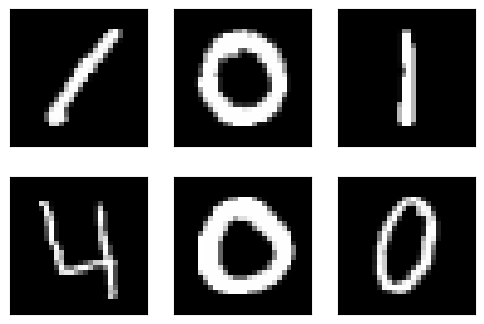

In [ ]:
# Show some digits
show(X, 2, 3, (6, 4))

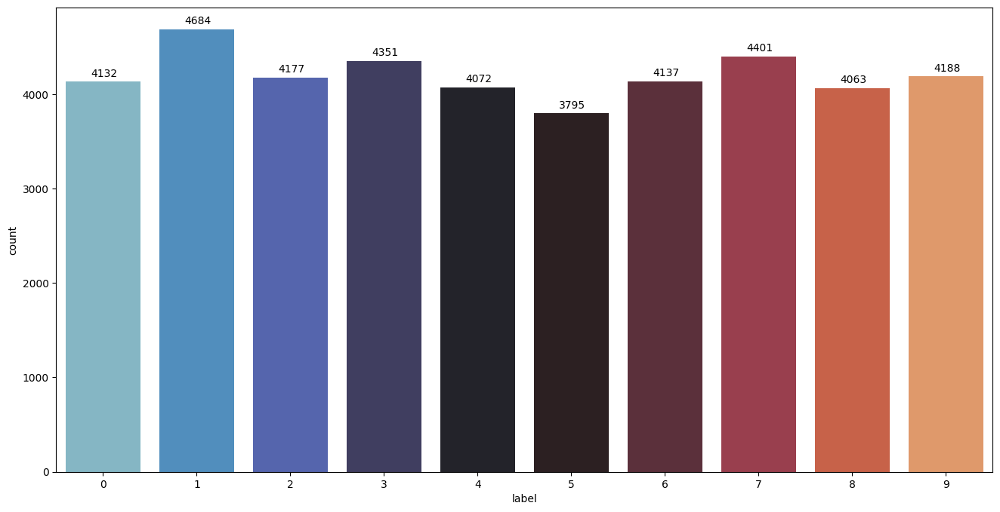

In [ ]:
# Digits classes
fig, ax = plt.subplots(figsize=(16, 8))
graph = sns.countplot(y, x='label', palette='icefire')

for p in graph.patches:
    height = p.get_height()
    ax.annotate(f'{int(height)}', xy=(p.get_x() + p.get_width() / 2., height),
                xytext=(1, 5), textcoords='offset points', ha='center')
plt.show()

In [ ]:
def thresh_to_black_background(image):
    _, binary_image = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    if np.sum(binary_image > 127) > image.size / 2:
        binary_image = cv2.bitwise_not(binary_image)
    return binary_image

In [ ]:
X_new = []
for x in X:
    binary_image = thresh_to_black_background(x)
    X_new.append(binary_image)
X_new = np.array(X_new)

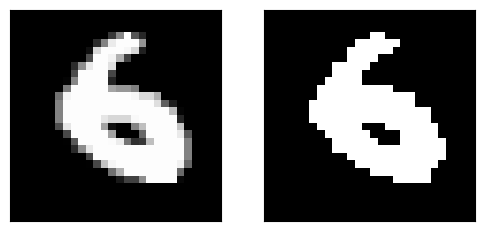

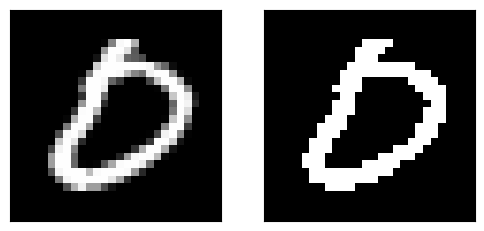

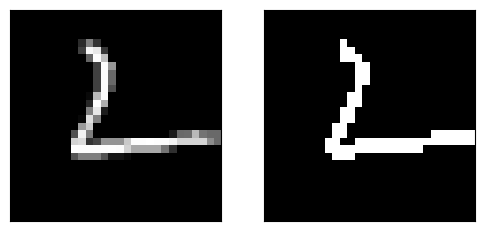

In [ ]:
# Images after process
indices = np.random.randint(0, len(X_new), 3)

for i in indices:
    show([X[i], X_new[i]], 1, 2)

In [ ]:
from keras.utils import to_categorical

# Prepare to X, y for training
X_scaled = X_new.reshape((-1, 28, 28, 1)) / 255.
y_one_hot = to_categorical(y, num_classes=10)

print(X_scaled.shape)
print(y_one_hot.shape)

(42000, 28, 28, 1)
(42000, 10)


In [ ]:
from sklearn.model_selection import train_test_split

# Split data into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_scaled, y_one_hot, test_size=0.1, random_state=20030607)

print('Train size:', X_train.shape)
print('Test size:', X_val.shape)

Train size: (37800, 28, 28, 1)
Test size: (4200, 28, 28, 1)


In [ ]:
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D
from keras.optimizers import RMSprop, Adam
from keras.preprocessing.image import ImageDataGenerator

model = Sequential([
    Conv2D(filters=16, kernel_size=(5, 5), padding='Same', activation='relu', input_shape=(28, 28, 1)),
    MaxPool2D(pool_size=(2,2)),
    Dropout(0.25),

    Conv2D(filters=32, kernel_size=(3, 3), padding='Same', activation='relu'),
    MaxPool2D(pool_size=(2,2), strides=(2,2)),

    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(10, activation='softmax')
])

optimizer = Adam(learning_rate=0.003, beta_1=0.9, beta_2=0.99)

In [ ]:
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
# Data augmentation
data_gen = ImageDataGenerator(
        zca_whitening=False,     # dimension reduction
        rotation_range=5,        # randomly rotate images in the range 5 degrees
        zoom_range = 0.1,        # randomly zoom image 10%
        width_shift_range=0.1,   # randomly shift images horizontally 10%
        height_shift_range=0.1)  # randomly shift images vertically 10%

data_gen.fit(X_train)

In [ ]:
epochs = 50
batch_size = 256

history = model.fit(data_gen.flow(X_train, y_train, batch_size=batch_size), epochs=epochs,
                    validation_data=(X_val, y_val), steps_per_epoch=X_train.shape[0] // batch_size)

Epoch 1/50
147/147 [==============================] - 17s 77ms/step - loss: 0.5727 - accuracy: 0.8125 - val_loss: 0.0959 - val_accuracy: 0.9719
Epoch 2/50
147/147 [==============================] - 11s 75ms/step - loss: 0.1970 - accuracy: 0.9400 - val_loss: 0.0697 - val_accuracy: 0.9786
Epoch 3/50
147/147 [==============================] - 11s 75ms/step - loss: 0.1465 - accuracy: 0.9557 - val_loss: 0.0625 - val_accuracy: 0.9812
Epoch 4/50
147/147 [==============================] - 10s 68ms/step - loss: 0.1289 - accuracy: 0.9614 - val_loss: 0.0420 - val_accuracy: 0.9867
Epoch 5/50
147/147 [==============================] - 10s 70ms/step - loss: 0.1086 - accuracy: 0.9667 - val_loss: 0.0462 - val_accuracy: 0.9855
Epoch 6/50
147/147 [==============================] - 11s 74ms/step - loss: 0.1005 - accuracy: 0.9693 - val_loss: 0.0383 - val_accuracy: 0.9881
Epoch 7/50
147/147 [==============================] - 11s 76ms/step - loss: 0.0948 - accuracy: 0.9714 - val_loss: 0.0391 - val_accuracy:

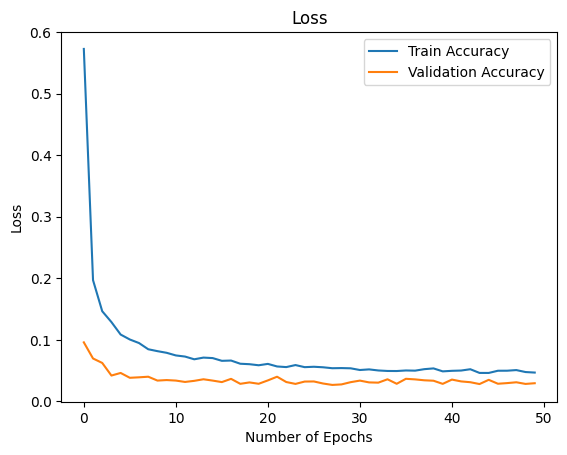

In [ ]:
plt.plot(history.history['loss'], label='Train Accuracy')
plt.plot(history.history['val_loss'], label='Validation Accuracy')
plt.title('Loss')
plt.xlabel("Number of Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()

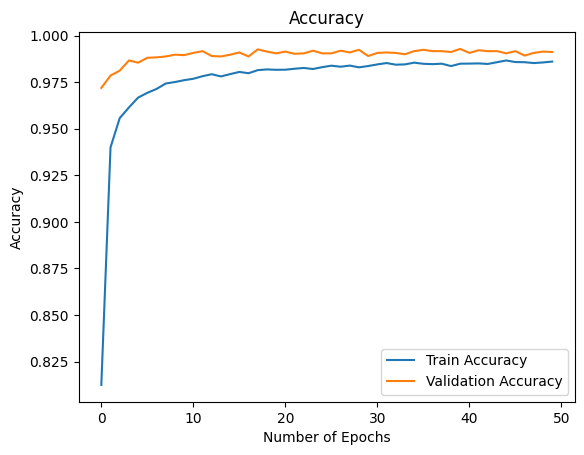

In [ ]:
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel("Number of Epochs")
plt.ylabel("Accuracy")
plt.legend()
plt.show()

In [ ]:
# Save model
model.save('/content/drive/MyDrive/DigitClassification/model.h5')

### Predict

In [ ]:
folder_path = '/content/drive/MyDrive/DigitClassification/PrivateTest'

images = os.listdir(folder_path)
print("The number of images: ", len(images))
print("Some image names:", images[:3])

The number of images:  1390
Some image names: ['01cf4f31eab4d0033cf31a0b4fd98f13  -.jpg', '019c83fa84804eabf41c306b52717cb9  -.png', '018dc36f628ca4eedff4b508d4c4625a  -.jpg']


In [ ]:
def process(image):
    path = os.path.join(folder_path, image)
    x = cv2.imread(path, 0)
    x = cv2.resize(x, (28, 28))
    x = thresh_to_black_background(x)
    return x

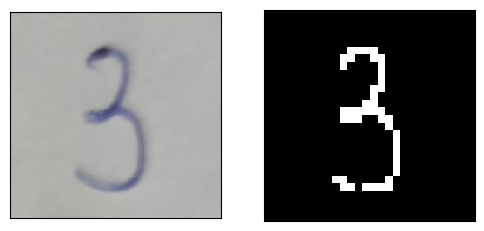

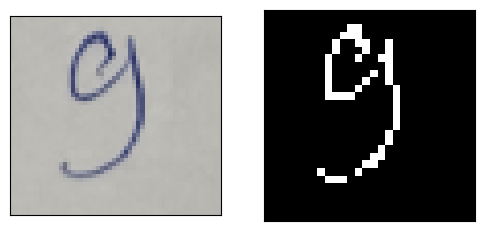

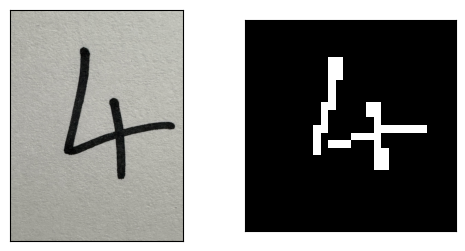

In [ ]:
# Show some images after processing
for image in np.random.choice(images, 3):
    show([os.path.join(folder_path, image), process(image)], 1, 2)

In [ ]:
# DataFrame for csv file
result_df = pd.DataFrame(index=images)
result_df['prediction'] = 0
result_df.head()

,prediction
01cf4f31eab4d0033cf31a0b4fd98f13 -.jpg,0
019c83fa84804eabf41c306b52717cb9 -.png,0
018dc36f628ca4eedff4b508d4c4625a -.jpg,0
1ba599edc95ab3c0572fef8d22b98964 -.jpg,0
01a41c015e1add1f2ca469cbb8e52d5a -.png,0


In [ ]:
from keras.models import load_model

# Load model
model = load_model('/content/drive/MyDrive/DigitClassification/model.h5')

In [ ]:
# Prepare images, predict and save it to dataframe
for image in result_df.index:
    path = os.path.join(folder_path, image)
    x = cv2.imread(path, 0)
    if x is None:
        continue
    x = cv2.resize(x, (28, 28))
    x = thresh_to_black_background(x)
    x = x.reshape(1, 28, 28, 1) / 255.

    # Predict
    pred = model.predict(x)
    pred = np.argmax(pred, axis=1)

    # Save result to dataframe
    result_df.loc[image, 'prediction'] = pred

1/1 [==============================] - 0s 17ms/step


In [ ]:
result_df.head()

,prediction
01cf4f31eab4d0033cf31a0b4fd98f13 -.jpg,5
019c83fa84804eabf41c306b52717cb9 -.png,4
018dc36f628ca4eedff4b508d4c4625a -.jpg,6
1ba599edc95ab3c0572fef8d22b98964 -.jpg,5
01a41c015e1add1f2ca469cbb8e52d5a -.png,3


In [ ]:
# Count the number for each class
result_df.value_counts()

prediction
1             255
7             164
2             163
3             162
5             149
8             117
0             105
4              97
6              92
9              86
Name: count, dtype: int64

In [ ]:
# Save to csv file
output_path = '/content/drive/MyDrive/DigitClassification/output.csv'
with open(output_path, 'w', newline='\r\n') as f:
    result_df.to_csv(f, index_label='image')

## MÔ TẢ HỖ TRỢ CỦA CÁC CÔNG CỤ NHƯ CHATGPT, GEMINI, POE

- Các SV mô tả vắn tắt việc dùng các công cụ để hỗ trợ cho việc thực hiện bài thực hành

# THỐNG KÊ DỮ LIỆU

1. Yêu cầu chung: Thống kê được số lượng ảnh trong từng phân loại mà mỗi SV đóng góp

2. Yêu cầu cụ thể:
- Input:
    + Thư mục cha chứa các thư mục con - mỗi thư mục con tương ứng với tên của từng hiệu xe (Honda, Suzuki, VinFast, Yamaha, Others). Ví dụ: https://drive.google.com/drive/u/1/folders/12WrC9APRzQX36cataTccBiN_Z5F2C0yD
    + Các ảnh được đặt tên theo quy ước: các tập tin ảnh theo quy ước https://colab.research.google.com/drive/1sZBm78OiTUOqbg5-Z2UOKlk3B37TAgd8
- Output:
    + File MotocycleDataset-1.csv - Thống kê số lượng ảnh theo từng SV
      + Mỗi dòng sẽ có các thông tin cách nhau bằng dấu phẩy, theo quy ước: MSSV, All, Số lượng.
        
        Ví dụ: 20221234, All, 1.2
      + Số lượng có thể là số thực vì một ảnh có thể có đóng góp từ nhiều sinh viên
    + File MotocycleDataset-2.csv - Thống kê số lượng ảnh theo từng Hiệu xe mà từng SV đóng góp
      + Mỗi dòng sẽ có các thông tin cách nhau bằng dấu phẩy, theo quy ước: MSSV, Hiệu xe, Số lượng.
        
        Ví dụ: 20221234, Honda, 1.2
      + Số lượng có thể là số thực vì một ảnh có thể có đóng góp từ nhiều sinh viên
      + Chỉ chấp nhận file .jpg, .jpeg và .png
3. Nộp bài: SV share notebook. Các bài nộp sớm sẽ được full điểm. Deadline: 17:00 - 08/06/2024

4. Bài làm đạt yêu cầu sẽ được paste vào notebook với ghi nhận đóng góp từ tác giả.

In [ ]:
from google.colab import drive
drive.flush_and_unmount()
!rm -rf /root/.config/Google/DriveFS
!rm -rf /root/.config/Google/gcloud
!rm -rf /content/drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import re
import csv
import pandas as pd
import random
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold
from sklearn.cluster import KMeans
from collections import defaultdict

In [ ]:
# thư mục gốc chứa thư mục dữ liệu
szWorkingDir = "/content/drive/MyDrive/Public"
# Khởi tạo từ điển để lưu trữ số lượng hình ảnh
student_total_counts = defaultdict(int)
student_brand_counts = defaultdict(lambda: defaultdict(int))

# Đuôi tệp hợp lệ
valid_extensions = {'.jpg', '.jpeg', '.png'}

# Định nghĩa các thư mục của các hãng xe
automakers = {
    'Yamaha': os.path.join(szWorkingDir, 'Yamaha'),
    'VinFast': os.path.join(szWorkingDir, 'VinFast'),
    'Suzuki': os.path.join(szWorkingDir, 'Suzuki'),
    'Others': os.path.join(szWorkingDir, 'Others'),
    'Honda': os.path.join(szWorkingDir, 'Honda')
}

# Hàm xử lý từng tệp
def process_file(file_name, brand):
    # Kiểm tra xem tệp có đuôi hợp lệ không
    if not any(file_name.lower().endswith(ext) for ext in valid_extensions):
        return

    # Tách tên tệp
    parts = file_name.split('.')
    if len(parts) != 4:
        return

    # Kiểm tra xem hình ảnh có thuộc đúng thương hiệu hay không
    if parts[-3] != brand:
        return

    # Lấy danh sách MSSV từ tên tệp
    mssvs = parts[0].split('-')

    # Cập nhật số lượng hình ảnh
    for mssv in mssvs:
        student_total_counts[mssv] += 1
        student_brand_counts[mssv][brand] += 1

# Đi qua từng thư mục của các hãng xe và xử lý tệp
for brand, path in automakers.items():
    if os.path.exists(path):
        for root, _, files in os.walk(path):
            for file_name in files:
                process_file(file_name, brand)

# Chuẩn bị dữ liệu để ghi vào tệp CSV
data_file1 = []
data_file2 = []

# Tạo dữ liệu cho file1 và file2
for student, total_count in student_total_counts.items():
    # Thêm dữ liệu vào file1
    data_file1.append([student, 'All', total_count])

    # Thêm dữ liệu vào file2
    for brand, count in student_brand_counts[student].items():
        data_file2.append([student, brand, count])

# Định nghĩa đường dẫn tệp đầu ra
basefolder = "/content/drive/MyDrive"
file1 = os.path.join(basefolder, 'MotocycleDataset-1.csv')
file2 = os.path.join(basefolder, 'MotocycleDataset-2.csv')

# Ghi dữ liệu vào tệp CSV
with open(file1, 'w', newline='') as f:
    writer = csv.writer(f)
    writer.writerow(['MSSV', 'All', 'Số lượng'])
    writer.writerows(data_file1)

with open(file2, 'w', newline='') as f:
    writer = csv.writer(f)
    writer.writerow(['MSSV', 'Hiệu xe', 'Số lượng'])
    writer.writerows(data_file2)

print("CSV files have been created successfully.")

CSV files have been created successfully.


In [ ]:
data = pd.read_csv(file1)
data.head(10)

,MSSV,All,Số lượng
0,22520968,All,5197
1,22520996,All,5197
2,22520999,All,5197
3,22520929,All,5197
4,22521373,All,5197
5,22521184,All,192
6,22520834,All,681
7,22520833,All,681
8,22520891,All,681
9,22520808,All,681


In [ ]:
# Dữ liệu nhóm chúng em đã cập nhật
file1 = '/content/drive/MyDrive/MotocycleDataset-1.csv'
data = pd.read_csv(file1)
ds_mssv = [22521184, 22521031, 22520197, 22520658]

In [ ]:
# Lọc dữ liệu dựa trên danh sách MSSV
filtered_data = data[data['MSSV'].isin(ds_mssv)]
print(filtered_data)
print(f"Tổng số lượt ảnh mà nhóm em đã đóng góp: {sum(filtered_data['Số lượng'])}")

        MSSV  All  Số lượng
5   22521184  All       192
12  22520197  All        50
86  22521031  All       250
87  22520658  All        30
Tổng số lượt ảnh mà nhóm em đã đóng góp: 522


/content/drive/MyDrive/Public/Honda/22521184.Honda.1.jpg


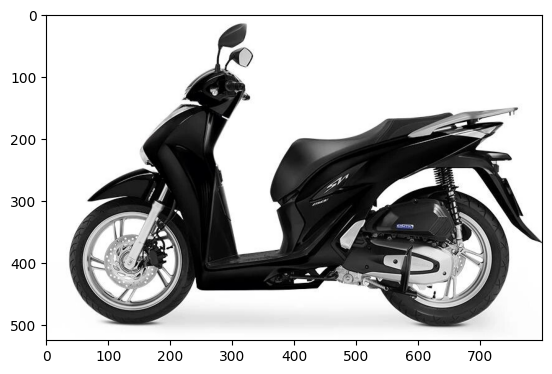

/content/drive/MyDrive/Public/Yamaha/22521031.Yamaha.1.jpg


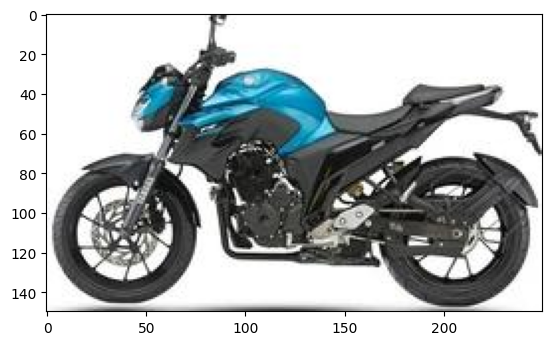

/content/drive/MyDrive/Public/Suzuki/22521031.Suzuki.1.jpg


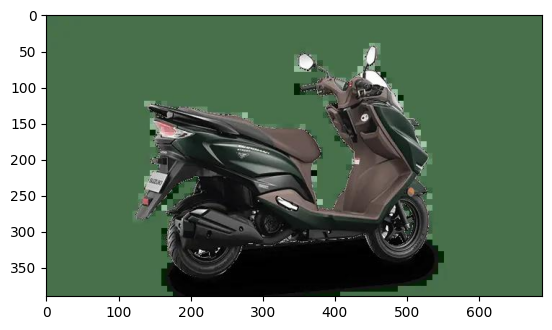

/content/drive/MyDrive/Public/VinFast/22521031.VinFast.46.jpg


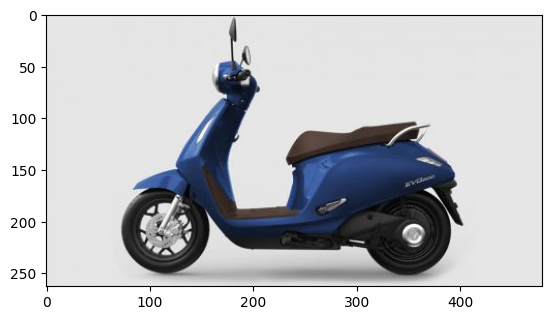

/content/drive/MyDrive/Public/Others/22521184.Others.1.jpg


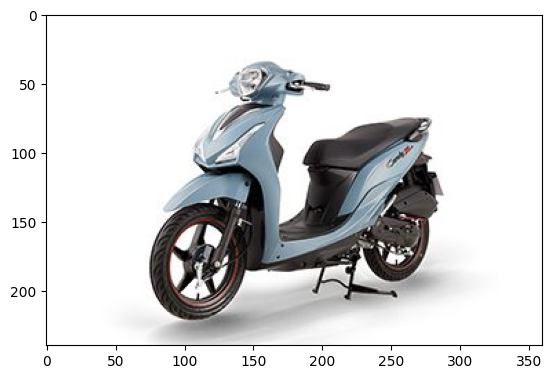

In [ ]:
# Một số hình ảnh mà nhóm chúng em đã đóng góp
folder = '/content/drive/MyDrive/Public'
image1 = os.path.join(folder, 'Honda/22521184.Honda.1.jpg')
image2 = os.path.join(folder, 'Yamaha/22521031.Yamaha.1.jpg')
image3 = os.path.join(folder, 'Suzuki/22521031.Suzuki.1.jpg')
image4 = os.path.join(folder, 'VinFast/22521031.VinFast.46.jpg')
image5 = os.path.join(folder, 'Others/22521184.Others.1.jpg')
print(image1)
plt.imshow(Image.open(image1))
plt.show()

print(image2)
plt.imshow(Image.open(image2))
plt.show()

print(image3)
plt.imshow(Image.open(image3))
plt.show()

print(image4)
plt.imshow(Image.open(image4))
plt.show()

print(image5)
plt.imshow(Image.open(image5))
plt.show()

# TẠO CÁC TẬP DỮ LIỆU TRAIN, TEST (SPLITS)

1. Yêu cầu chung: Tạo ra các splits, mỗi split tương ứng với một tập dữ liệu train - test
  + Bài học lý thuyết (để trả lời cho các câu hỏi như vì sao phải cần việc này, thực hiện việc này như thế nào):
    - https://www.kaggle.com/code/satishgunjal/tutorial-k-fold-cross-validation
    - https://machinelearningmastery.com/training-validation-test-split-and-cross-validation-done-right/
    - https://machinelearningmastery.com/how-to-configure-k-fold-cross-validation/

  <IMG SRC = 'https://raw.githubusercontent.com/satishgunjal/images/master/KFold_Cross_Validation.png'>
2. Yêu cầu cụ thể:
- Input:
    + Thư mục cha chứa các thư mục con - mỗi thư mục con tương ứng với tên của từng hiệu xe (Honda, Suzuki, VinFast, Yamaha, Others). Ví dụ: https://drive.google.com/drive/u/1/folders/12WrC9APRzQX36cataTccBiN_Z5F2C0yD
    + Các ảnh được đặt tên theo quy ước: các tập tin ảnh theo quy ước https://colab.research.google.com/drive/1sZBm78OiTUOqbg5-Z2UOKlk3B37TAgd8
    + Số splits NumSplits - mặc định NumSplits=5 (tương đương 5-fold CV)
- Output:
    + File MotocycleDataset.csv - Tập tin chứa tất cả ảnh của dataset
      - Chương trình sẽ scan qua cây thư mục để tìm tất cả các ảnh (chỉ chọn các ảnh có định dạng + phần mở rộng là .jpg)
      - Mỗi dòng sẽ có các thông tin cách nhau bằng dấu phẩy, theo quy ước: ImageFullPath, CategoryID
            - ImageFullPath ở dạng <Thư mục Hiệu xe>/<Tên ảnh>. Ví dụ: Honda/2024123.Honda.1.jpg.
            - CategoryID là số nguyên thuộc [0..5] theo quy ước
              - 0: Others
              - 1: Honda
              - 2: Suzuki
              - 3: Yamaha
              - 4: VinFast     
    + File MotocycleDataset-Splits-[1..5]-[Train/Test].csv - Phân chia thành các splits, mỗi split gồm các ảnh được chia thành thành 2 tập Train - Test
      + Chương trình sẽ đọc dữ liệu từ file  MotocycleDataset.csv, sau đó với mỗi hiệu xe, chia ngẫu nhiên thành 5 tập dữ liệu. Lưu ý là phải chia theo hiệu xe, để đảm bảo dữ liệu Train/Test có dữ liệu của các hiệu xe.
      + Từ 5 tập dữ liệu chia ngẫu nhiên theo các hiệu xe Xij (i là thứ tự tập dữ liệu, j là CategoryID), gom lại thành 5 tập dữ liệu lớn hơn Xi, sao cho mỗi tập dữ liệu này chứa đủ dữ liệu của tất cả các hiệu xe. Tức là Xi = Union(Xij)       
      + Từ 5 tập dữ liệu Xi này (tương ứng với FOLDi ở trong hình vẽ trên), tạo ra 5 splits Split-i
      + Với mỗi bộ dữ liệu Split-i, ghi xuống thành 2 tập tin tương ứng với Train, Test. Ví dụ Split-1 thì ghi thành tập tin  MotocycleDataset-Splits-1-Train.csv và MotocycleDataset-Splits-1-Test.csv. Tập Train gồm 4 bộ, Test gồm bộ còn lại. Ví dụ,
          + Split-1: tập Train sẽ gồm X2, X3, X4, X5, tập Test là X1
          + Split-5: tập Train sẽ gồm X1, X2, X3, X4, tập Test là X5
      + Mỗi dòng sẽ có các thông tin cách nhau bằng dấu phẩy, theo quy ước: ImageFullPath, CategoryID
- Lưu ý:
  - Nên viết thêm các cell
    - Hiển thị danh sách các tên tập tin ảnh trong từng Split-Train/Test,
    - Thống kê các ảnh cho từng CategoryID trong mỗi Split-Train/Test
  - Cần có chú thích
3. Nộp bài: SV share notebook. Các bài nộp sớm sẽ được full điểm. Deadline: 17:00 - 10/06/2024

4. Bài làm đạt yêu cầu sẽ được paste vào notebook với ghi nhận đóng góp từ tác giả.

In [ ]:
base_folder = '/content/drive/MyDrive/Public'

# Define categories dictionary
categories = {
    'Others': 0,
    'Honda': 1,
    'Suzuki': 2,
    'Yamaha': 3,
    'VinFast': 4
}

# File name for CSV
file_name = "MotocycleDataset.csv"


# Create CSV file
with open(file_name, 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['ImageFullPath', 'CategoryID'])  # Write the header row

    # Walk through base folder
    for category in categories.keys():
        category_folder = os.path.join(base_folder, category)
        if os.path.exists(category_folder):
            for root, dirs, files in os.walk(category_folder):
                for filename in files:
                    if filename.lower().endswith('.jpg'):  # Only process .jpg files
                        image_full_path = os.path.relpath(os.path.join(root, filename), base_folder)
                        category_id = categories[category]
                        writer.writerow([image_full_path, category_id])

file_path = os.path.join(base_folder, file_name)
print(f"File {file_name} has been created successfully at {file_path}.")

File MotocycleDataset.csv has been created successfully at /content/drive/MyDrive/Public/MotocycleDataset.csv.


In [ ]:
file_path = '/content/drive/My Drive/MotocycleDataset.csv'
df = pd.read_csv(file_path)
print(df)

                                           ImageFullPath  CategoryID
0      Others/22521705-22520777-22520202-22521304-225...           0
1      Others/22521705-22520777-22520202-22521304-225...           0
2      Others/22521705-22520777-22520202-22521304-225...           0
3      Others/22521705-22520777-22520202-22521304-225...           0
4      Others/22521705-22520777-22520202-22521304-225...           0
...                                                  ...         ...
24258   VinFast/22520054-22521626-22521322.VinFast.4.jpg           4
24259   VinFast/22520054-22521626-22521322.VinFast.6.jpg           4
24260   VinFast/22520054-22521626-22521322.VinFast.8.jpg           4
24261   VinFast/22520054-22521626-22521322.VinFast.1.jpg           4
24262   VinFast/22520054-22521626-22521322.VinFast.2.jpg           4

[24263 rows x 2 columns]


In [ ]:
# Số lượng folds
n_splits = 5

# Tạo đường dẫn thư mục đầu ra nếu nó không tồn tại
output_dir = '/content/drive/MyDrive/MotocycleDataset-Splits'
os.makedirs(output_dir, exist_ok=True)

# Sử dụng KFold để chia dữ liệu thành các fold
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
folds = list(kf.split(df['ImageFullPath']))

# Duyệt qua các fold và tạo các tệp CSV tương ứng
for fold, (train_idx, test_idx) in enumerate(folds, 1):
    # Lấy dữ liệu huấn luyện và dữ liệu kiểm tra từ các chỉ mục của fold hiện tại
    train_data = df.iloc[train_idx]
    test_data = df.iloc[test_idx]

    # Tạo tên tệp cho dữ liệu huấn luyện và dữ liệu kiểm tra
    train_file = os.path.join(output_dir, f'MotocycleDataset-Splits-{fold}-Train.csv')
    test_file = os.path.join(output_dir, f'MotocycleDataset-Splits-{fold}-Test.csv')

    # Lưu dữ liệu vào các tệp CSV mà không bao gồm chỉ mục và tiêu đề
    train_data.to_csv(train_file, index=False, header=False)
    test_data.to_csv(test_file, index=False, header=False)

    # In thông báo sau khi tạo xong các tệp
    print(f"Created {train_file} and {test_file}")


Created /content/drive/MyDrive/MotocycleDataset-Splits/MotocycleDataset-Splits-1-Train.csv and /content/drive/MyDrive/MotocycleDataset-Splits/MotocycleDataset-Splits-1-Test.csv
Created /content/drive/MyDrive/MotocycleDataset-Splits/MotocycleDataset-Splits-2-Train.csv and /content/drive/MyDrive/MotocycleDataset-Splits/MotocycleDataset-Splits-2-Test.csv
Created /content/drive/MyDrive/MotocycleDataset-Splits/MotocycleDataset-Splits-3-Train.csv and /content/drive/MyDrive/MotocycleDataset-Splits/MotocycleDataset-Splits-3-Test.csv
Created /content/drive/MyDrive/MotocycleDataset-Splits/MotocycleDataset-Splits-4-Train.csv and /content/drive/MyDrive/MotocycleDataset-Splits/MotocycleDataset-Splits-4-Test.csv
Created /content/drive/MyDrive/MotocycleDataset-Splits/MotocycleDataset-Splits-5-Train.csv and /content/drive/MyDrive/MotocycleDataset-Splits/MotocycleDataset-Splits-5-Test.csv


In [ ]:
import plotly.graph_objects as go

# Duyệt qua các fold để hiển thị thống kê số lượng ảnh cho mỗi CategoryID trong từng tập dữ liệu Split-Train/Test
for fold in range(1, n_splits + 1):
    train_file = os.path.join(output_dir, f'MotocycleDataset-Splits-{fold}-Train.csv')
    test_file = os.path.join(output_dir, f'MotocycleDataset-Splits-{fold}-Test.csv')

    train_data = pd.read_csv(train_file, header=None, names=['ImageFullPath', 'CategoryID'])
    test_data = pd.read_csv(test_file, header=None, names=['ImageFullPath', 'CategoryID'])

    # Tạo biểu đồ cột cho thống kê số lượng ảnh cho mỗi CategoryID trong tập dữ liệu Split-Train
    fig = go.Figure(data=[go.Bar(x=train_data['CategoryID'].value_counts().index, y=train_data['CategoryID'].value_counts().values)])
    fig.update_layout(title=f'MotocycleDataset-Splits-Train {fold}', xaxis_title='CategoryID', yaxis_title='Image Count')
    fig.show()

    # Tạo biểu đồ cột cho thống kê số lượng ảnh cho mỗi CategoryID trong tập dữ liệu Split-Test
    fig = go.Figure(data=[go.Bar(x=test_data['CategoryID'].value_counts().index, y=test_data['CategoryID'].value_counts().values)])
    fig.update_layout(title=f'MotocycleDataset-Splits-Test {fold}', xaxis_title='CategoryID', yaxis_title='Image Count')
    fig.show()

In [ ]:
# Duyệt qua các fold để hiển thị thông tin về dữ liệu huấn luyện và kiểm tra của mỗi fold
for fold in range(1, n_splits + 1):
    # Tạo đường dẫn đến các tệp dữ liệu huấn luyện và kiểm tra cho fold hiện tại
    train_file = os.path.join(output_dir, f'MotocycleDataset-Splits-{fold}-Train.csv')
    test_file = os.path.join(output_dir, f'MotocycleDataset-Splits-{fold}-Test.csv')

    # Đọc dữ liệu từ các tệp CSV và lưu vào DataFrame, đặt tên cột
    train_data = pd.read_csv(train_file, header=None, names=['ImageFullPath', 'CategoryID'])
    test_data = pd.read_csv(test_file, header=None, names=['ImageFullPath', 'CategoryID'])

    # In thông tin về dữ liệu huấn luyện của fold hiện tại
    print(f"Training data (fold {fold}):")
    print(train_data.head(10))  # In ra 10 dòng đầu tiên của dữ liệu huấn luyện

    # In thông tin về dữ liệu kiểm tra của fold hiện tại
    print(f"Testing data (fold {fold}):")
    print(test_data.head(10))  # In ra 10 dòng đầu tiên của dữ liệu kiểm tra


Training data (fold 1):
                                       ImageFullPath  CategoryID
0  Others/22521705-22520777-22520202-22521304-225...           0
1  Others/22521705-22520777-22520202-22521304-225...           0
2  Others/22521705-22520777-22520202-22521304-225...           0
3  Others/22521705-22520777-22520202-22521304-225...           0
4  Others/22521705-22520777-22520202-22521304-225...           0
5  Others/22521705-22520777-22520202-22521304-225...           0
6  Others/22521705-22520777-22520202-22521304-225...           0
7  Others/22521705-22520777-22520202-22521304-225...           0
8  Others/22521705-22520777-22520202-22521304-225...           0
9  Others/22521705-22520777-22520202-22521304-225...           0
Testing data (fold 1):
                                       ImageFullPath  CategoryID
0  Others/22521705-22520777-22520202-22521304-225...           0
1  Others/22521705-22520777-22520202-22521304-225...           0
2  Others/22521705-22520777-22520202-225213

# HIỂN THỊ DANH SÁCH CÁC ẢNH CỦA TẬP DỮ LIỆU

1. Yêu cầu chung: Hiển thị một số ảnh trong bộ dữ liệu theo từng phân loại
  + Ví dụ minh họa:
  <IMG SRC = 'https://editor.analyticsvidhya.com/uploads/762161_OSvbuPLy0PSM2nZ62SbtlQ.png'>
2. Yêu cầu cụ thể:
  - Input: tập tin .csv, trong đó mỗi dòng tương ứng với (đường dẫn) một ảnh và categoryID. Ví dụ tập tin MotocycleDataset-Splits-1-Train.csv (xem bài https://colab.research.google.com/drive/1gf0GzvW0tHddKtuvMUNIvglUT-J6oW6S?usp=sharing)
  - Output: như hình minh họa ở trên, mỗi dòng tương ứng với một CategoryID, số lượng ảnh, kích thước ảnh là các tham số với giá trị mặc định như sau
    + NumImgsPerRow = 10
    + ImgHeight = ImgWidth = 150
  - Các ảnh mỗi dòng được chọn ngẫu nhiên ở mỗi lần chạy

3. Nộp bài: SV share notebook. Các bài nộp sớm sẽ được full điểm. Deadline: 17:00 - 10/06/2024

4. Bài làm đạt yêu cầu sẽ được paste vào notebook với ghi nhận đóng góp từ tác giả.

In [ ]:
# Hàm display_images chúng em đã tham khảo CHATGPT
def display_images(data, base_folder='', num_imgs_per_category=10, img_height=150, img_width=150):
    categories = data['CategoryID'].unique()
    category_names = {0: 'Others', 1: 'Honda', 2: 'Suzuki', 3: 'Yamaha', 4: 'Vinfast'}

    num_categories = len(categories)
    fig, axes = plt.subplots(num_categories, num_imgs_per_category, figsize=(num_imgs_per_category * 2, num_categories * 2))

    for row, category in enumerate(categories):
        category_data = data[data['CategoryID'] == category]
        img_paths = category_data['ImageFullPath'].tolist()

        if len(img_paths) > num_imgs_per_category:
            img_paths = random.sample(img_paths, num_imgs_per_category)
        else:
            img_paths = img_paths[:num_imgs_per_category]

        for col, img_path in enumerate(img_paths):
            ax = axes[row, col]
            img_filename = os.path.basename(img_path)
            img_category_folder = os.path.dirname(img_path)
            full_img_path = os.path.join(base_folder, img_category_folder, img_filename)

            if not os.path.exists(full_img_path):
                ax.axis('off')
                continue

            try:
                img = Image.open(full_img_path)
                img = img.resize((img_width, img_height), Image.ANTIALIAS)
                ax.imshow(img)
                ax.axis('off')
            except Exception as e:
                ax.axis('off')

        axes[row, 0].text(-0.5, 0.5, category_names.get(category, 'Unknown'), rotation=0,
                          verticalalignment='center', horizontalalignment='right', fontsize=14)
        axes[row, 0].axis('off')

    for row in range(num_categories):
        for col in range(len(img_paths), num_imgs_per_category):
            ax = axes[row, col]
            ax.axis('off')

    plt.tight_layout()
    plt.subplots_adjust(left=0.15, right=0.95, top=0.95, bottom=0.05)
    plt.show()

def display_images_from_splits(output_dir, n_splits):
    for fold in range(1, n_splits + 1):
        train_file = os.path.join(output_dir, f'MotocycleDataset-Splits-{fold}-Train.csv')
        test_file = os.path.join(output_dir, f'MotocycleDataset-Splits-{fold}-Test.csv')

        train_data = pd.read_csv(train_file, header=None, names=['ImageFullPath', 'CategoryID'])
        test_data = pd.read_csv(test_file, header=None, names=['ImageFullPath', 'CategoryID'])

        # Hiển thị hình ảnh từ tập train
        print(f"Displaying images from Split-Train {fold}")
        display_images(train_data, base_folder='/content/drive/MyDrive/Public')

        # Hiển thị hình ảnh từ tập test
        print(f"Displaying images from Split-Test {fold}")
        display_images(test_data, base_folder='/content/drive/MyDrive/Public')

Displaying images from Split-Train 1


<ipython-input-8-a6a7485b57ac>:29: DeprecationWarning:

ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.



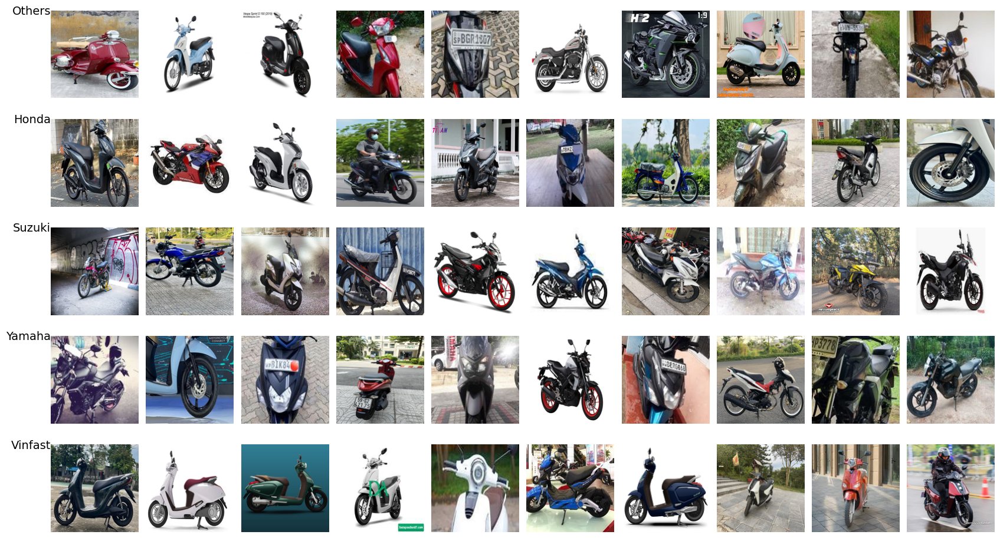

Displaying images from Split-Test 1


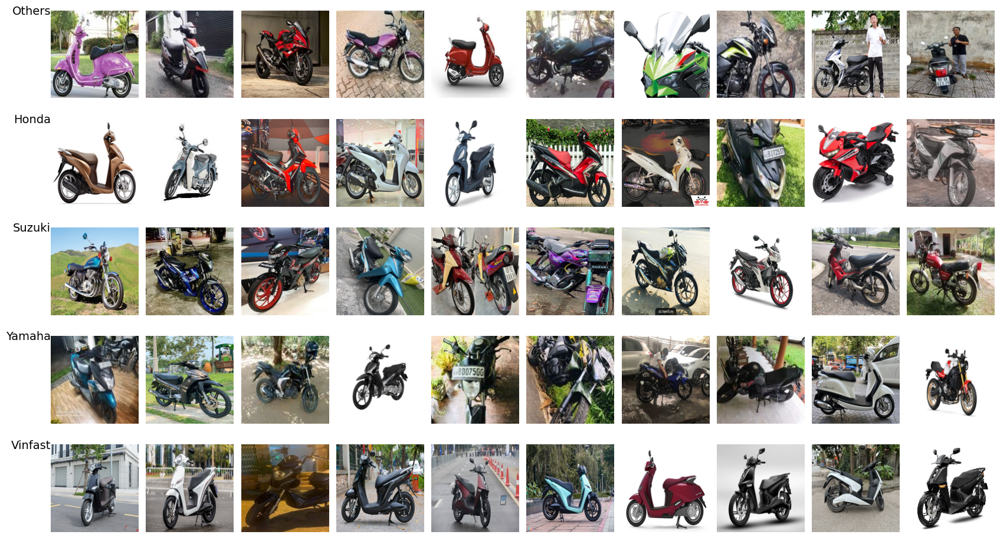

Displaying images from Split-Train 2


<ipython-input-8-a6a7485b57ac>:29: DeprecationWarning:

ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.



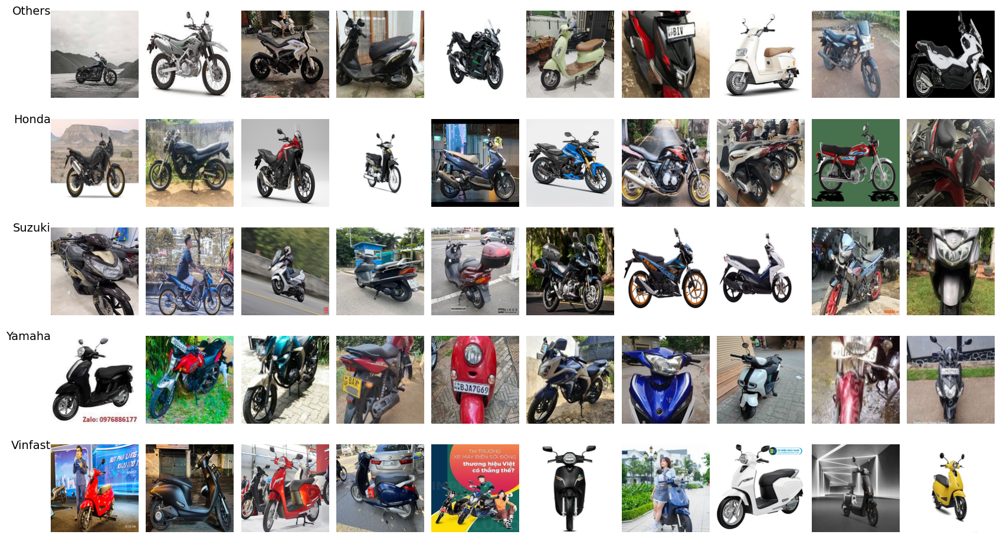

Displaying images from Split-Test 2


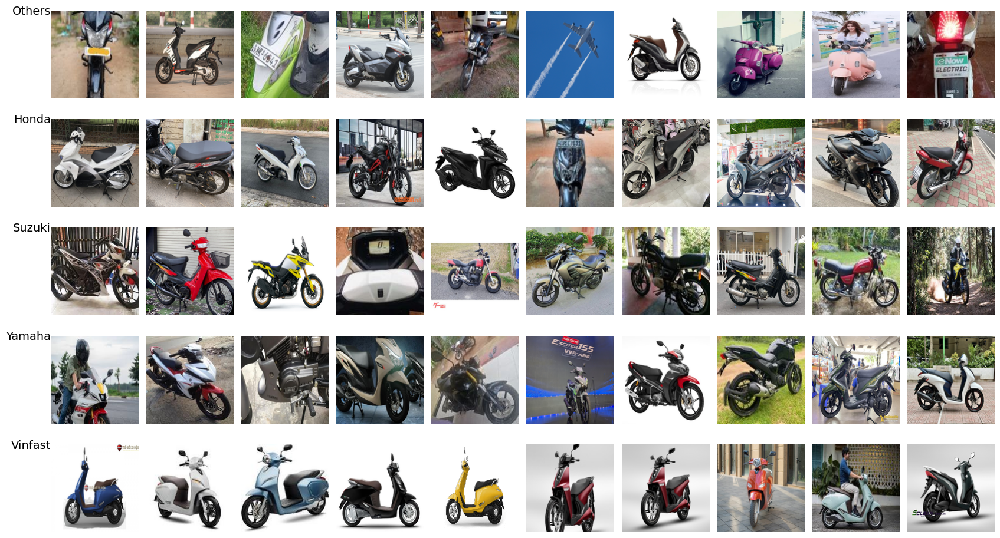

Displaying images from Split-Train 3


<ipython-input-8-a6a7485b57ac>:29: DeprecationWarning:

ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.



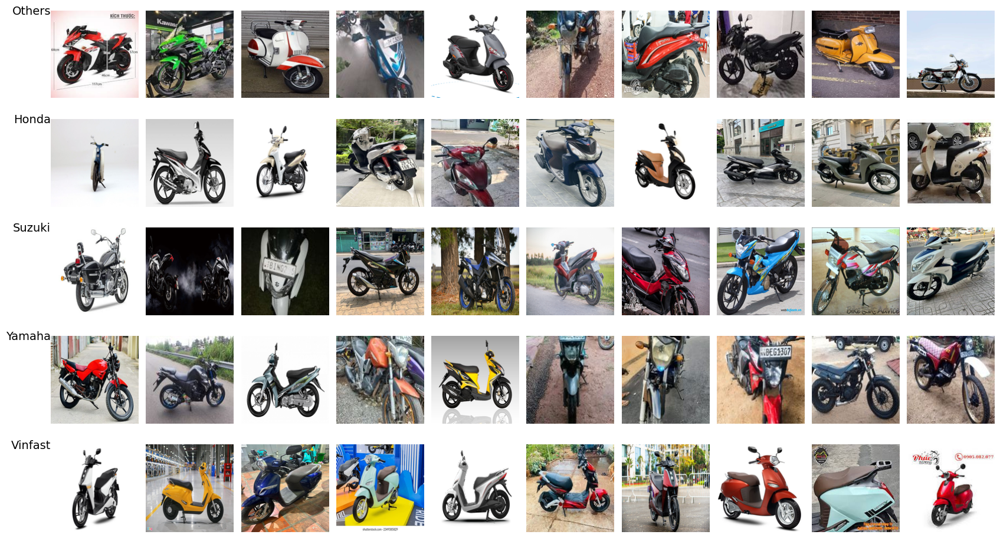

Displaying images from Split-Test 3


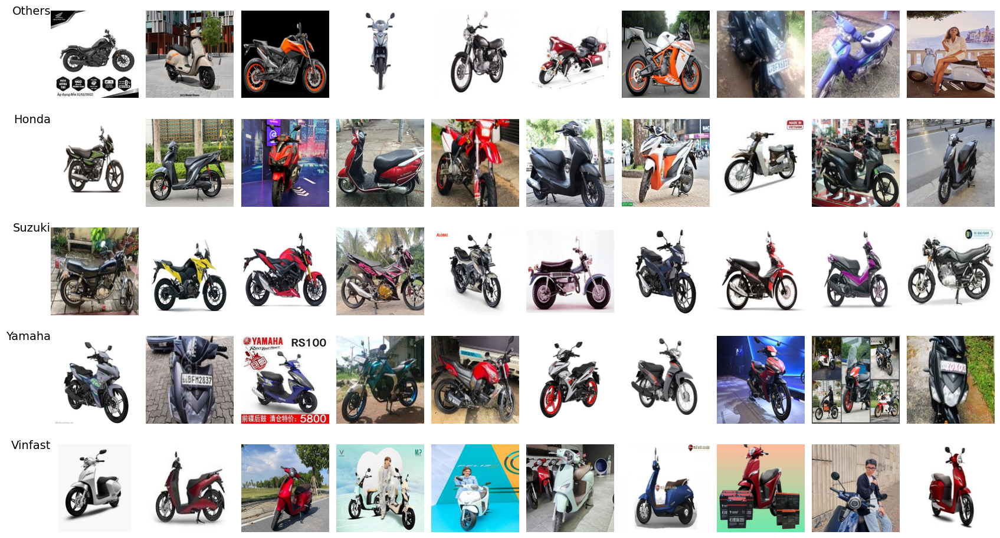

Displaying images from Split-Train 4


<ipython-input-8-a6a7485b57ac>:29: DeprecationWarning:

ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.



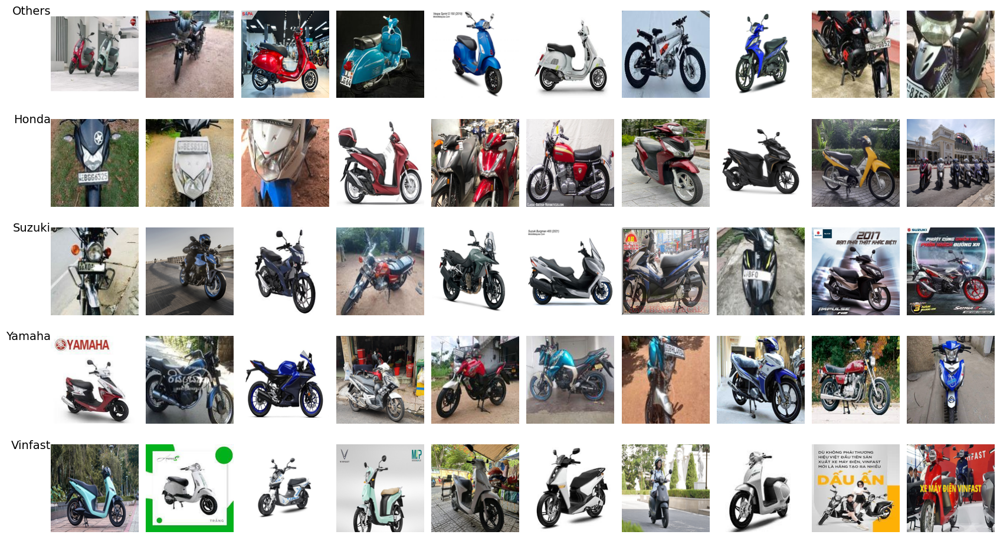

Displaying images from Split-Test 4


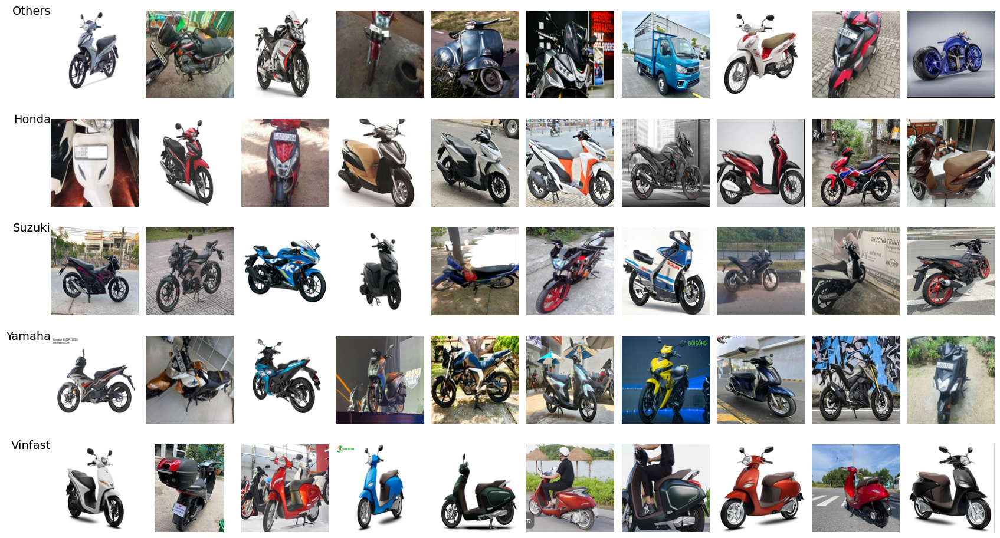

Displaying images from Split-Train 5


<ipython-input-8-a6a7485b57ac>:29: DeprecationWarning:

ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.



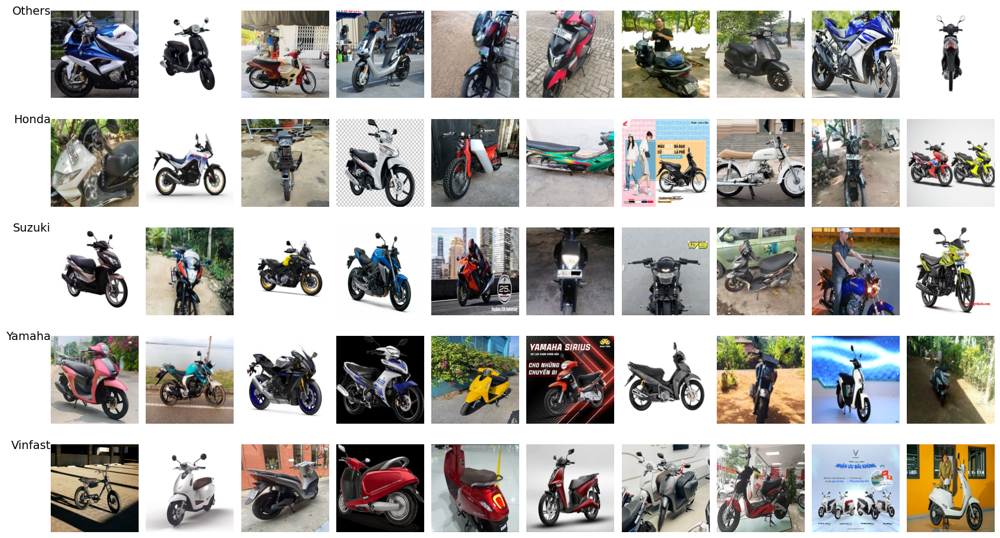

Displaying images from Split-Test 5


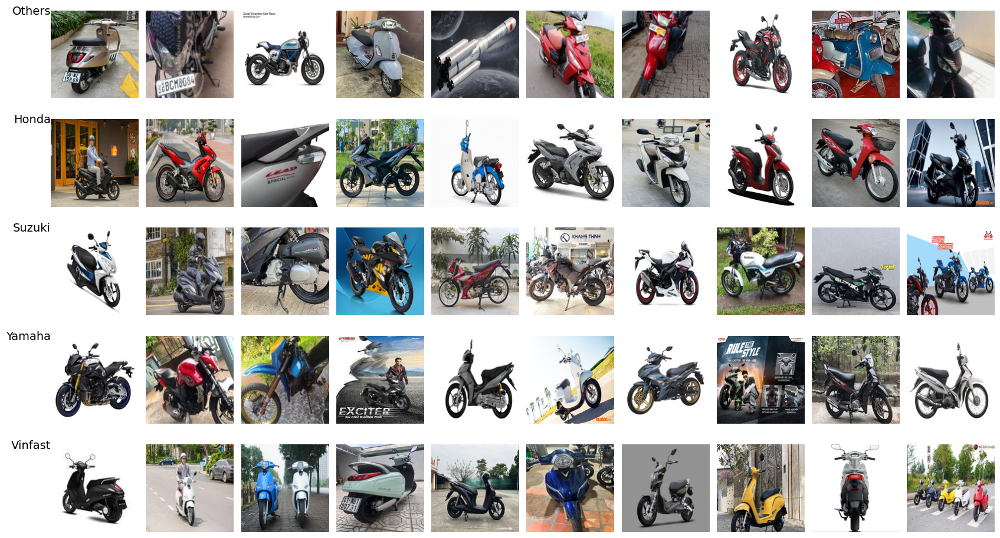

In [ ]:
# Đường dẫn đến thư mục chứa các tệp split
output_dir = 'MotocycleDataset-Splits'
base_folder = '/content/drive/MyDrive/Public'  # Thay đổi đường dẫn này thành thư mục chứa các ảnh của bạn
n_splits = 5

# Hiển thị các ảnh từ các tệp split
display_images_from_splits(output_dir, n_splits)

# ỨNG DỤNG CLUSTERING ĐỂ PHÁT HIỆN ẢNH TRÙNG

1. Yêu cầu chung: Dùng kỹ thuật clustering để tạo công cụ hỗ trợ phát hiện các ảnh trùng nhau

2. Yêu cầu cụ thể:
  - Input: Danh sách các ảnh được lưu trong tập tin, ví dụ MotocycleDataset-Splits-1-Train.csv (xem mô tả https://colab.research.google.com/drive/1gf0GzvW0tHddKtuvMUNIvglUT-J6oW6S?usp=sharing)
  - Output: Danh sách các clusters và hiển thị các ảnh trong cluster

3. Hướng dẫn:
  - Bước 1:
    - Mỗi ảnh cần thực hiện bước rút trích đặc trưng (feature extraction), biểu diễn dưới dạng một vector đặc trưng d chiều (d-dimension).
    - Có nhiều công cụ hỗ trợ bước rút trích đặc trưng, trong bài tập này, chúng ta sẽ chọn một công cụ sao cho tốc độ xử lý nhanh nhưng kết quả tốt. Các mô hình MobileNet (https://keras.io/api/applications/mobilenet/) có thể được dùng vì đáp ứng các tiêu chí này.
  - Bước 2:
    - Chọn một thuật toán clustering - ví dụ K-Means (số lượgn clusters K=5)
    - Ghi kết quả clustering ra tập tin - thay CategoryID bằng ClusterID
  - Bước 3:
    - Hiển thị kết quả clustering - kế thừa kết quả của bài tập Hiển thị dữ liệu https://colab.research.google.com/drive/1rHbKlJd7O9E49SsJlHnZNKcyTbwXT_Ls?usp=sharing
    - Từ kết quả hiển thị, nếu các ảnh nhìn trùng nhau, nhưng tên tập tin khác nhau thì có thể đưa vào danh sách hậu kiểm.

In [ ]:
!pip install tensorflow

In [ ]:
!pip install keras

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.mobilenet import preprocess_input
from sklearn.cluster import KMeans

In [ ]:
model = MobileNet(weights='imagenet', include_top=False, pooling='avg')

In [ ]:
def load_and_preprocess_image(img_path):
    # Tải hình ảnh từ đường dẫn và thay đổi kích thước về 224x224 pixel
    img = image.load_img(img_path, target_size=(224, 224))

    # Chuyển đổi hình ảnh thành mảng numpy (dạng dữ liệu số)
    img_data = image.img_to_array(img)

    # Mở rộng chiều của mảng để phù hợp với đầu vào của mô hình (thêm một chiều batch)
    img_data = np.expand_dims(img_data, axis=0)

    # Tiền xử lý hình ảnh theo yêu cầu của mô hình (ví dụ: chuẩn hóa)
    img_data = preprocess_input(img_data)

    # Trả về hình ảnh đã được tiền xử lý
    return img_data

def extract_features_batch(image_paths):
    # Đặt kích thước của mỗi batch là 32
    batch_size = 32

    # Lấy số lượng hình ảnh
    num_images = len(image_paths)

    # Tạo một danh sách để lưu trữ các đặc trưng của tất cả các hình ảnh
    features_list = []

    # Lặp qua danh sách hình ảnh theo từng batch
    for i in range(0, num_images, batch_size):
        # Lấy các đường dẫn hình ảnh cho batch hiện tại
        batch_paths = image_paths[i:i+batch_size]

        # Tiền xử lý tất cả các hình ảnh trong batch hiện tại
        batch_images = np.vstack([load_and_preprocess_image(img_path) for img_path in batch_paths])

        # Dự đoán đặc trưng cho batch hiện tại bằng mô hình
        batch_features = model.predict(batch_images)

        # Thêm các đặc trưng của batch hiện tại vào danh sách
        features_list.extend(batch_features)

    # Chuyển danh sách các đặc trưng thành mảng numpy và trả về
    return np.array(features_list)

In [ ]:
train_file = os.path.join(output_dir, f'MotocycleDataset-Splits-1-Train.csv')
data = pd.read_csv(train_file, header=None, names=["ImageFullPath", "CategoryID"])

image_paths = [os.path.join(base_folder, row['ImageFullPath']) for _, row in data.iterrows() if os.path.exists(os.path.join(base_folder, row['ImageFullPath']))]
labels_list = [row['CategoryID'] for _, row in data.iterrows() if os.path.exists(os.path.join(base_folder, row['ImageFullPath']))]

features_list = extract_features_batch(image_paths)

1/1 [==============================] - 1s 1s/step


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning:

Palette images with Transparency expressed in bytes should be converted to RGBA images



1/1 [==============================] - 1s 1s/step


In [ ]:
X = np.array(features_list)
original_labels = np.array(labels_list)

# Number of clusters
K = 20

# Perform K-Means clustering
kmeans = KMeans(n_clusters=K, random_state=0).fit(X)
cluster_labels = kmeans.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
# Update the DataFrame with cluster labels
df_clusters = data[['ImageFullPath']].copy()
df_clusters['ClusterID'] = cluster_labels

# Path and filename for the output CSV file
output_dir = '/content/drive/MyDrive'
os.makedirs(output_dir, exist_ok=True)
output_csv = os.path.join(output_dir, 'MotocycleDataset-Splits-1-Train-Clusters.csv')

# Save DataFrame to CSV file
df_clusters.to_csv(output_csv, index=False, header=['ImageFullPath', 'ClusterID'])

In [ ]:
file = '/content/drive/My Drive/MotocycleDataset-Splits-1-Train-Clusters.csv'
data = pd.read_csv(file)
data.head(10)

,ImageFullPath,ClusterID
0,Others/22521705-22520777-22520202-22521304-225...,13
1,Others/22521705-22520777-22520202-22521304-225...,19
2,Others/22521705-22520777-22520202-22521304-225...,11
3,Others/22521705-22520777-22520202-22521304-225...,8
4,Others/22521705-22520777-22520202-22521304-225...,5
5,Others/22521705-22520777-22520202-22521304-225...,19
6,Others/22521705-22520777-22520202-22521304-225...,3
7,Others/22521705-22520777-22520202-22521304-225...,12
8,Others/22521705-22520777-22520202-22521304-225...,3
9,Others/22521705-22520777-22520202-22521304-225...,13


<ipython-input-19-f1fe0e03f8ce>:27: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((img_width, img_height), Image.ANTIALIAS)


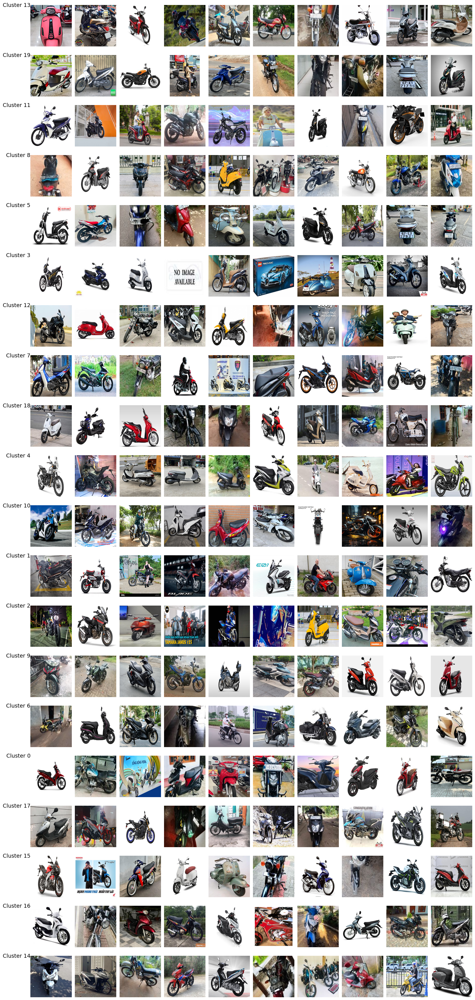

In [ ]:
# Hàm display_cluster_images chúng em đã tham khảo CHATGPT
def display_cluster_images(data, base_folder='', num_imgs_per_category=10, img_height=150, img_width=150):
    clusters = data['ClusterID'].unique()
    num_clusters = len(clusters)
    fig, axes = plt.subplots(num_clusters, num_imgs_per_category, figsize=(num_imgs_per_category * 2, num_clusters * 2))

    for row, cluster in enumerate(clusters):
        cluster_data = data[data['ClusterID'] == cluster]
        img_paths = cluster_data['ImageFullPath'].tolist()

        if len(img_paths) > num_imgs_per_category:
            img_paths = random.sample(img_paths, num_imgs_per_category)
        else:
            img_paths = img_paths[:num_imgs_per_category]

        for col, img_path in enumerate(img_paths):
            ax = axes[row, col]
            img_filename = os.path.basename(img_path)
            img_category_folder = os.path.dirname(img_path)
            full_img_path = os.path.join(base_folder, img_category_folder, img_filename)

            if not os.path.exists(full_img_path):
                ax.axis('off')
                continue

            try:
                img = Image.open(full_img_path)
                img = img.resize((img_width, img_height), Image.ANTIALIAS)
                ax.imshow(img)
                ax.axis('off')
            except Exception as e:
                ax.axis('off')

        axes[row, 0].text(-0.5, 0.5, f'Cluster {cluster}', rotation=0,
                          verticalalignment='center', horizontalalignment='right', fontsize=14)
        axes[row, 0].axis('off')

    for row in range(num_clusters):
        for col in range(len(img_paths), num_imgs_per_category):
            ax = axes[row, col]
            ax.axis('off')

    plt.tight_layout()
    plt.subplots_adjust(left=0.15, right=0.95, top=0.95, bottom=0.05)
    plt.show()

# Load the clustering results
clustered_data = pd.read_csv(file, header=None, names=["ImageFullPath", "ClusterID"])
display_cluster_images(clustered_data, base_folder=base_folder)

# HUẤN LUYỆN MODEL

1. Yêu cầu chung: Huấn luỵện model dựa trên tập ảnh đầu vào có gán nhãn
  - Tham khảo: https://colab.research.google.com/drive/1bOzVaDQo8h6Ngstb7AcfzC35OihpHspt
2. Yêu cầu cụ thể:
  - Input: Tập tin Train của một split, ví dụ MotocycleDataset-Splits-1-Train.csv
  - Output: Model sau khi train xong
  - Hình vẽ của learning curve

3. Lưu ý:
  - Sử dụng feature như MobileNetV2 để rút trích đặc trưng cho mỗi ảnh.
  - Chọn một thuật toán learning - ví dụ logistic regression
  - Thử prompt sau trong chatgpt

    ```
    Tôi muốn viết một đoạn code để train một model multi-class classification
    - input là tập các ảnh với 5 loại khác nhau
    - feature extraction dùng mobilenetv2
    - learning algorithm dùng logistic regression
    - framework keras
    ```



In [ ]:
import numpy as np
import os
import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
from PIL import Image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D, Input
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing import image

In [ ]:
def plot_learning_curves(i, history):
    # Vẽ biểu đồ accuracy
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    # Vẽ biểu đồ loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.legend(loc='lower right')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.show()

In [ ]:
def preprocess_image(image_path, target_size, preprocess_func):
    try:
        # Mở và thay đổi kích thước hình ảnh
        image = Image.open(image_path)
        image = image.resize(target_size)

        # Chuyển đổi hình ảnh thành mảng numpy
        image = np.array(image)

        # Kiểm tra xem hình ảnh có đúng là 3 kênh (RGB) hay không
        if image.ndim != 3 or image.shape[2] != 3:
            return None

        # Tiền xử lý hình ảnh bằng hàm preprocess_func (chuẩn hóa giá trị pixel)
        image = preprocess_func(image)

        return image
    except Exception as e:
        return None

def filter_valid_images(dataframe, directory, x_col, target_size, preprocess_func):
    valid_rows = []
    for index, row in dataframe.iterrows():
        image_path = os.path.join(directory, row[x_col])
        if os.path.exists(image_path):
            # Tiền xử lý hình ảnh và kiểm tra tính hợp lệ
            image = preprocess_image(image_path, target_size, preprocess_func)
            if image is not None:
                valid_rows.append(row)
    return pd.DataFrame(valid_rows)

In [ ]:
base_path = '/content/drive/MyDrive'
base_folder = '/content/drive/MyDrive/Public'

#Tham Số
image_size = (224, 224)
batch_size = 32
num_epochs = 10
num_classes = 5

# Khởi tạo base model cho trích xuất đặc trưng
base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

def train_model(i, train_generator, val_generator):
    # Freeze the base model
    base_model.trainable = False

    # Create the model
    inputs = Input(shape=(224, 224, 3))
    x = base_model(inputs, training=False)
    x = GlobalAveragePooling2D()(x) #Chúng em có tham khảo CHATGPT
    x = Dense(256, activation='relu')(x) #Chúng em có tham khảo CHATGPT
    x = Dropout(0.5)(x) #Chúng em có tham khảo CHATGPT
    outputs = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs, outputs)
    # Khởi tạo Adam với learning rate là 0.0001
    #adam_optimizer = Adam(learning_rate=0.0001)
    # Điều chỉnh learning rate là 0.001 với tập splits 2->5
    adam_optimizer = Adam(learning_rate=0.001)
    # Biên dịch mô hình
    model.compile(optimizer=adam_optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

    # Huấn luyện mô hình
    history = model.fit(
        train_generator,
        epochs=num_epochs,
        batch_size=batch_size,
        validation_data = val_generator
    )

    # Lưu model
    model_path = os.path.join(base_path, f'model{i}.h5')
    model.save(model_path)

    plot_learning_curves(i, history)
    return np.mean(history.history['accuracy'])

9406464/9406464 [==============================] - 0s 0us/step


In [ ]:
file_train = os.path.join(base_folder, f'MotocycleDataset-Splits-{1}-Train.csv')
file_val = os.path.join(base_folder, f'MotocycleDataset-Splits-{1}-Test.csv')

name_colums = ['ImageFullPath', 'CategoryID']
df_train = pd.read_csv(file_train, names=name_colums)
df_val = pd.read_csv(file_val, names=name_colums)

# Kích thước DataFrame
print(df_train.shape)

print(df_val.shape)

(28042, 2)
(7011, 2)


In [ ]:
# Kiểm tra, và loại bỏ các hình ảnh không hợp lệ từ DataFrame
df_train = filter_valid_images(df_train, base_folder, 'ImageFullPath', image_size, preprocess_input)
df_val = filter_valid_images(df_val, base_folder, 'ImageFullPath', image_size, preprocess_input)

#Kích thước DataFrame sau khi loại bỏ một số hình ảnh ko hợp lệ
print(df_train.shape)

print(df_val.shape)

(25589, 2)
(6394, 2)


In [ ]:
df_train['CategoryID'] = df_train['CategoryID'].astype(str)  # Chuyển kiểu dữ liệu cột CategoryID từ int sang string
df_val['CategoryID'] = df_val['CategoryID'].astype(str)  # Chuyển kiểu dữ liệu cột CategoryID từ int sang string

In [ ]:
file_train = os.path.join(base_path, f'train.csv')
file_val = os.path.join(base_path, f'val.csv')
df_train = pd.read_csv(file_train)
df_val = pd.read_csv(file_val)

(1024, 732)


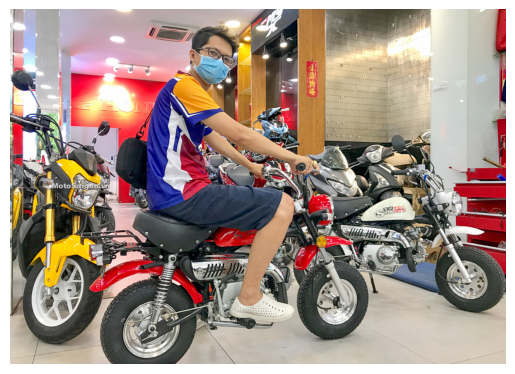

In [ ]:
# Ảnh trước khi xử lý
img = Image.open(os.path.join(base_folder, df_train['ImageFullPath'][0]))
print(img.size)
plt.imshow(img)
plt.axis('off')
plt.show()

In [ ]:
# Khởi tạo ImageDataGenerator với preprocessing_function
datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

# Tạo train_generator từ dataframe df_train
train_generator = datagen.flow_from_dataframe(
    dataframe=df_train,                  # DataFrame chứa đường dẫn hình ảnh và nhãn
    directory=base_folder,               # Thư mục chứa các hình ảnh
    x_col='ImageFullPath',               # Cột chứa đường dẫn đến hình ảnh
    y_col='CategoryID',                  # Cột chứa nhãn của hình ảnh
    target_size=image_size,              # Kích thước ảnh đầu vào (224x224)
    batch_size=batch_size,               # Kích thước của mỗi batch (32)
    class_mode='categorical',            # Chế độ nhãn: one-hot encoding cho phân loại
    shuffle=True                         # Xáo trộn dữ liệu sau mỗi epoch
)

# Tạo val_generator từ dataframe df_val
val_generator = datagen.flow_from_dataframe(
    dataframe=df_val,                    # DataFrame chứa đường dẫn hình ảnh và nhãn
    directory=base_folder,               # Thư mục chứa các hình ảnh
    x_col='ImageFullPath',               # Cột chứa đường dẫn đến hình ảnh
    y_col='CategoryID',                  # Cột chứa nhãn của hình ảnh
    target_size=image_size,              # Kích thước ảnh đầu vào (224x224)
    batch_size=batch_size,               # Kích thước của mỗi batch (32)
    class_mode='categorical',            # Chế độ nhãn: one-hot encoding cho phân loại
    shuffle=False                        # Không xáo trộn dữ liệu để đánh giá chính xác
)

Found 25589 validated image filenames belonging to 5 classes.
Found 6394 validated image filenames belonging to 5 classes.


(32, 224, 224, 3)


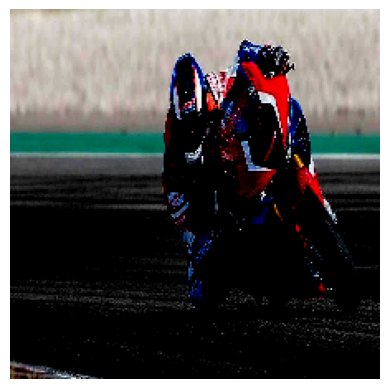

In [ ]:
# Kích thước ảnh sau khi xử lý, do trong xử lý ảnh có tính chất ngẫu nhiên nên ảnh sau khi xử lý khác với ảnh trước khi xử lý
batch = next(train_generator)
print(batch[0].shape)
image = batch[0][0]
plt.imshow(image)
plt.axis('off')
plt.show()

Epoch 1/10
800/800 [==============================] - 1758s 2s/step - loss: 1.4449 - accuracy: 0.3759 - val_loss: 1.2836 - val_accuracy: 0.4601
Epoch 2/10
800/800 [==============================] - 1736s 2s/step - loss: 1.2621 - accuracy: 0.4665 - val_loss: 1.1853 - val_accuracy: 0.5186
Epoch 3/10
800/800 [==============================] - 1745s 2s/step - loss: 1.1799 - accuracy: 0.5114 - val_loss: 1.1283 - val_accuracy: 0.5421
Epoch 4/10
800/800 [==============================] - 1779s 2s/step - loss: 1.1157 - accuracy: 0.5493 - val_loss: 1.0844 - val_accuracy: 0.5690
Epoch 5/10
800/800 [==============================] - 2587s 3s/step - loss: 1.0663 - accuracy: 0.5714 - val_loss: 1.0551 - val_accuracy: 0.5788
Epoch 6/10
800/800 [==============================] - 1759s 2s/step - loss: 1.0195 - accuracy: 0.5953 - val_loss: 1.0285 - val_accuracy: 0.5974
Epoch 7/10
800/800 [==============================] - 1761s 2s/step - loss: 0.9852 - accuracy: 0.6127 - val_loss: 1.0078 - val_accuracy:

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


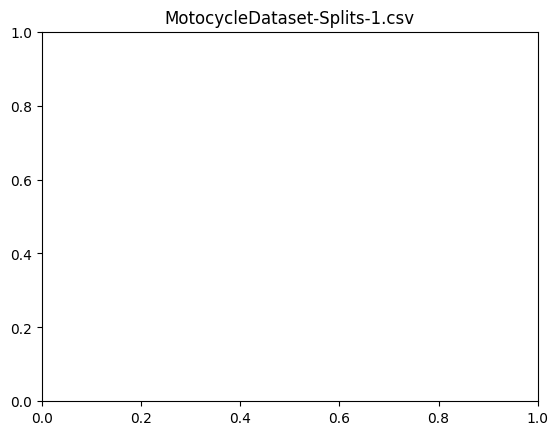

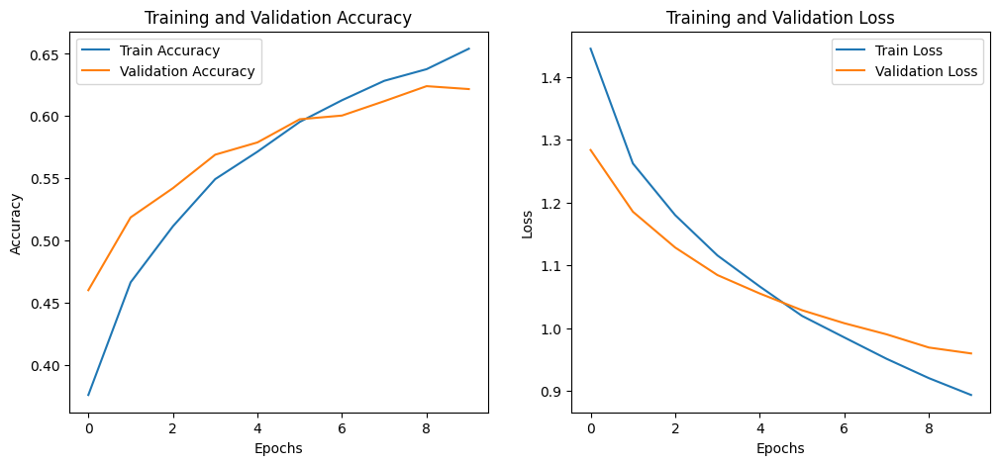

0.5602641820907592

In [ ]:
train_model(1, train_generator, val_generator)

Nhãn của ảnh đầu tiên: 1
1/1 [==============================] - 1s 1s/step
Class 0: 21.25%
Class 1: 21.83%
Class 2: 21.28%
Class 3: 19.36%
Class 4: 16.29%
Nhãn model dự đoán cho ảnh đầu tiên: 1


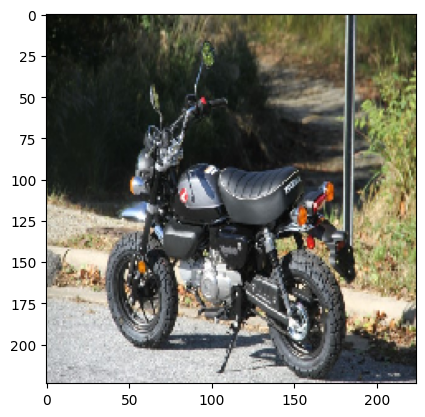

In [ ]:
# Dự đoán với ảnh đầu tiên cho model_1
from keras.models import load_model
import keras

base_path = '/content/drive/MyDrive'
base_folder = '/content/drive/MyDrive/Public'

model_path = os.path.join(base_path, 'model1.h5')
model = load_model(model_path)

file_test = os.path.join(base_folder, 'MotocycleDataset-Splits-1-Test.csv')
file_test_pred = os.path.join(base_path, 'MotocycleDataset-Splits-1-Test-Pred.csv')

name_colums = ['ImageFullPath', 'CategoryID']
df_test = pd.read_csv(file_test, names = name_colums)

#Nhãn cho ảnh đầu tiên
print(f"Nhãn của ảnh đầu tiên: {df_test['CategoryID'][0]}")

#Dự đoán với ảnh đầu tiên
img_path = os.path.join(base_folder, df_test['ImageFullPath'][0])
img = keras.utils.load_img(img_path, target_size = image_size) # Chúng em có tham khảo tại trang https://keras.io/examples/vision/image_classification_from_scratch/
plt.imshow(img)

img_data = load_and_preprocess_image(img_path)
pred = model.predict(img_data)
# Tính xác suất cho từng lớp bằng hàm softmax
scores = tf.nn.softmax(pred[0]).numpy() # Chúng em có tham khảo tại trang https://keras.io/examples/vision/image_classification_from_scratch/
                                        # nhưng vì có 5 class nên chúng em đã sử dụng hàm softmax thay vì dùng sigmoid

# In ra xác suất cho từng lớp
for i, score in enumerate(scores):
    print(f"Class {i}: {score * 100:.2f}%")

# Lấy lớp có xác suất cao nhất
predicted_class = np.argmax(scores)
print(f"Nhãn model dự đoán cho ảnh đầu tiên: {predicted_class}")

**SPLITS_2**

In [ ]:
file_train_2 = os.path.join(base_folder, f'MotocycleDataset-Splits-{2}-Train.csv')
file_val_2 = os.path.join(base_folder, f'MotocycleDataset-Splits-{2}-Test.csv')

name_colums = ['ImageFullPath', 'CategoryID']
df_train_2 = pd.read_csv(file_train_2, names=name_colums)
df_val_2 = pd.read_csv(file_val_2, names=name_colums)

In [ ]:
def generator(df_t, df_v, base_folder, image_size, batch_size = 32):
  datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

  train_generator = datagen.flow_from_dataframe(
    dataframe=df_t,
    directory=base_folder,
    x_col='ImageFullPath',
    y_col='CategoryID',
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle = True,
  )

  val_generator = datagen.flow_from_dataframe(
    dataframe=df_v,
    directory=base_folder,
    x_col='ImageFullPath',
    y_col='CategoryID',
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle = False,
  )
  return train_generator, val_generator

(940, 627)


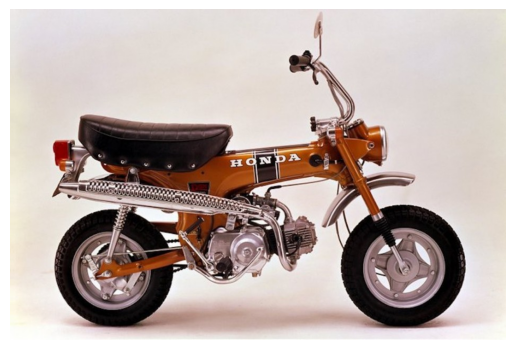

In [ ]:
# Ảnh trước khi xử lý
img = Image.open(os.path.join(base_folder, df_train_2['ImageFullPath'][0]))
print(img.size)
plt.imshow(img)
plt.axis('off')
plt.show()

In [ ]:
# Kiểm travà loại bỏ các hình ảnh không hợp lệ từ DataFrame
df_train_2 = filter_valid_images(df_train_2, base_folder, 'ImageFullPath', image_size, preprocess_input)
df_val_2 = filter_valid_images(df_val_2, base_folder, 'ImageFullPath', image_size, preprocess_input)

In [ ]:
df_train_2['CategoryID'] = df_train_2['CategoryID'].astype(str)  # Chuyển int sang string
df_val_2['CategoryID'] = df_val_2['CategoryID'].astype(str)  # Chuyển int sang string

print(df_train_2.shape)

print(df_val_2.shape)

(25590, 2)
                                           ImageFullPath CategoryID
0      Honda/22520968-22520996-22520999-22520929-2252...          1
1      Honda/22520968-22520996-22520999-22520929-2252...          1
2      Honda/22520968-22520996-22520999-22520929-2252...          1
3      Honda/22520968-22520996-22520999-22520929-2252...          1
4      Honda/22520968-22520996-22520999-22520929-2252...          1
...                                                  ...        ...
25585  Others/22520033-22520035-22520083-22520148-225...          0
25586  Others/22520033-22520035-22520083-22520148-225...          0
25587  Others/22520033-22520035-22520083-22520148-225...          0
25588  Others/22520033-22520035-22520083-22520148-225...          0
25589  Others/22520033-22520035-22520083-22520148-225...          0

[25590 rows x 2 columns]
(6393, 2)
                                          ImageFullPath CategoryID
0     Honda/22520968-22520996-22520999-22520929-2252...          1
1  

In [ ]:
train_generator, val_generator = generator(df_train_2, df_val_2, base_folder, image_size)

Found 25590 validated image filenames belonging to 5 classes.
Found 6393 validated image filenames belonging to 5 classes.


In [ ]:
batch = next(train_generator)
batch[0].shape

(32, 224, 224, 3)

In [ ]:
print(batch[0][0])

[[[ 0.4901961   0.43529415  0.35686278]
  [ 0.5294118   0.45882356  0.38823533]
  [ 0.5137255   0.43529415  0.35686278]
  ...
  [ 0.20784318  0.13725495  0.082353  ]
  [ 0.254902    0.18431377  0.12941182]
  [ 0.27058828  0.20000005  0.16078436]]

 [[ 0.45882356  0.4039216   0.32549024]
  [ 0.4901961   0.41960788  0.34901965]
  [ 0.49803925  0.41960788  0.3411765 ]
  ...
  [ 0.24705887  0.17647064  0.12156868]
  [ 0.32549024  0.254902    0.20000005]
  [ 0.37254906  0.30196083  0.26274514]]

 [[ 0.4666667   0.41176474  0.33333337]
  [ 0.47450984  0.4039216   0.33333337]
  [ 0.5058824   0.427451    0.34901965]
  ...
  [ 0.30196083  0.2313726   0.17647064]
  [ 0.27058828  0.20000005  0.14509809]
  [ 0.27843142  0.20784318  0.1686275 ]]

 ...

 [[ 0.4901961   0.3411765   0.20784318]
  [ 0.5529412   0.4039216   0.27058828]
  [ 0.54509807  0.39607847  0.27843142]
  ...
  [ 0.27843142  0.12941182  0.082353  ]
  [ 0.33333337  0.18431377  0.15294123]
  [ 0.20784318  0.06666672  0.05098045]]

 [

(224, 224, 3)


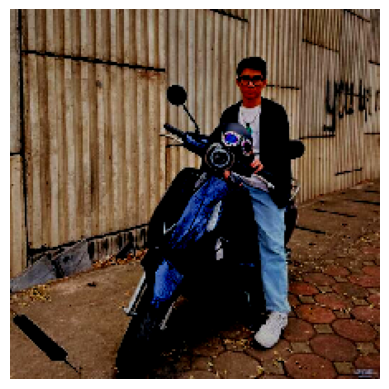

In [ ]:
# Ảnh sau khi được xử lý
print(batch[0][0].shape)
plt.imshow(batch[0][0])
plt.axis('off')
plt.show()

Epoch 1/10
800/800 [==============================] - 1849s 2s/step - loss: 1.3288 - accuracy: 0.4322 - val_loss: 1.1554 - val_accuracy: 0.5296
Epoch 2/10
800/800 [==============================] - 1804s 2s/step - loss: 1.1605 - accuracy: 0.5140 - val_loss: 1.0653 - val_accuracy: 0.5712
Epoch 3/10
800/800 [==============================] - 1717s 2s/step - loss: 1.0900 - accuracy: 0.5501 - val_loss: 1.0296 - val_accuracy: 0.5842
Epoch 4/10
800/800 [==============================] - 1689s 2s/step - loss: 1.0393 - accuracy: 0.5763 - val_loss: 0.9973 - val_accuracy: 0.6038
Epoch 5/10
800/800 [==============================] - 1639s 2s/step - loss: 0.9936 - accuracy: 0.5934 - val_loss: 0.9627 - val_accuracy: 0.6160
Epoch 6/10
800/800 [==============================] - 1715s 2s/step - loss: 0.9529 - accuracy: 0.6107 - val_loss: 0.9591 - val_accuracy: 0.6177
Epoch 7/10
800/800 [==============================] - 1931s 2s/step - loss: 0.9304 - accuracy: 0.6222 - val_loss: 0.9510 - val_accuracy:

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


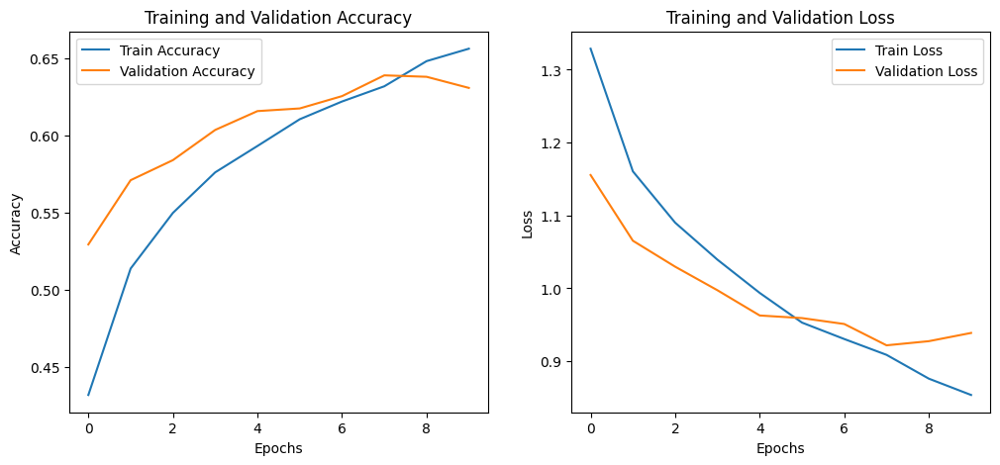

0.5835638910531997

In [ ]:
train_model(2, train_generator, val_generator)

**SPLITS_3**

In [ ]:
file_train_3 = os.path.join(base_folder, f'MotocycleDataset-Splits-3-Train.csv')
file_val_3 = os.path.join(base_folder, f'MotocycleDataset-Splits-3-Test.csv')

name_colums = ['ImageFullPath', 'CategoryID']
df_train_3 = pd.read_csv(file_train_3, names = name_colums)
df_val_3 = pd.read_csv(file_val_3, names = name_colums)

In [ ]:
# Kiểm tra và loại bỏ các hình ảnh không hợp lệ từ DataFrame
df_train_3 = filter_valid_images(df_train_3, base_folder, 'ImageFullPath', image_size, preprocess_input)
df_val_3 = filter_valid_images(df_val_3, base_folder, 'ImageFullPath', image_size, preprocess_input)

In [ ]:
df_train_3['CategoryID'] = df_train_3['CategoryID'].astype(str)  # Chuyển int sang string
df_val_3['CategoryID'] = df_val_3['CategoryID'].astype(str)  # Chuyển int sang string

print(df_train_3.shape)
print(df_val_3.shape)

(25587, 2)
(6396, 2)


In [ ]:
train_generator, val_generator = generator(df_train_3, df_val_3, base_folder, image_size)

Found 25587 validated image filenames belonging to 5 classes.
Found 6396 validated image filenames belonging to 5 classes.


Epoch 1/10
800/800 [==============================] - 1843s 2s/step - loss: 1.3308 - accuracy: 0.4340 - val_loss: 1.1768 - val_accuracy: 0.5030
Epoch 2/10
800/800 [==============================] - 1663s 2s/step - loss: 1.1740 - accuracy: 0.5101 - val_loss: 1.0776 - val_accuracy: 0.5633
Epoch 3/10
800/800 [==============================] - 1638s 2s/step - loss: 1.1052 - accuracy: 0.5472 - val_loss: 1.0452 - val_accuracy: 0.5733
Epoch 4/10
800/800 [==============================] - 1710s 2s/step - loss: 1.0590 - accuracy: 0.5670 - val_loss: 1.0114 - val_accuracy: 0.5879
Epoch 5/10
800/800 [==============================] - 1744s 2s/step - loss: 1.0166 - accuracy: 0.5870 - val_loss: 0.9829 - val_accuracy: 0.5974
Epoch 6/10
800/800 [==============================] - 1609s 2s/step - loss: 0.9741 - accuracy: 0.6035 - val_loss: 0.9756 - val_accuracy: 0.6043
Epoch 7/10
800/800 [==============================] - 1783s 2s/step - loss: 0.9471 - accuracy: 0.6196 - val_loss: 0.9476 - val_accuracy:

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


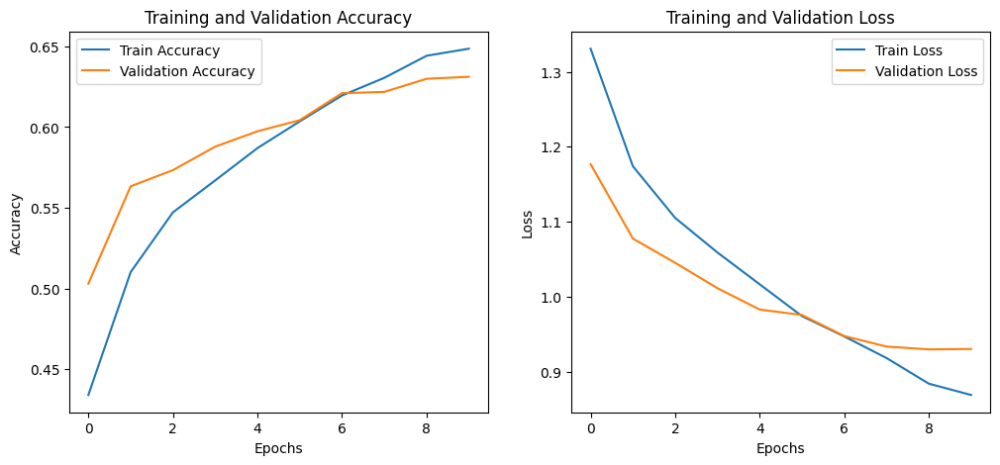

0.5791613072156906

In [ ]:
train_model(3, train_generator, val_generator)

**SPLITS_4**

In [ ]:
file_train_4 = os.path.join(base_folder, f'MotocycleDataset-Splits-4-Train.csv')
file_val_4 = os.path.join(base_folder, f'MotocycleDataset-Splits-4-Test.csv')

name_colums = ['ImageFullPath', 'CategoryID']
df_train_4 = pd.read_csv(file_train_4, names = name_colums)
df_val_4 = pd.read_csv(file_val_4, names = name_colums)

In [ ]:
# Kiểm tra và loại bỏ các hình ảnh không hợp lệ từ DataFrame
df_train_4 = filter_valid_images(df_train_4, base_folder, 'ImageFullPath', image_size, preprocess_input)
df_val_4 = filter_valid_images(df_val_4, base_folder, 'ImageFullPath', image_size, preprocess_input)

In [ ]:
df_train_4['CategoryID'] = df_train_4['CategoryID'].astype(str)  # Chuyển int sang string
df_val_4['CategoryID'] = df_val_4['CategoryID'].astype(str)  # Chuyển int sang string

print(df_train_4.shape)
print(df_val_4.shape)

(25578, 2)
(6405, 2)


In [ ]:
train_generator, val_generator = generator(df_train_4, df_val_4, base_folder, image_size)

Found 25578 validated image filenames belonging to 5 classes.
Found 6405 validated image filenames belonging to 5 classes.


Epoch 1/10
800/800 [==============================] - 1133s 1s/step - loss: 1.3291 - accuracy: 0.4327 - val_loss: 1.1673 - val_accuracy: 0.5347
Epoch 2/10
800/800 [==============================] - 1084s 1s/step - loss: 1.1631 - accuracy: 0.5140 - val_loss: 1.0898 - val_accuracy: 0.5585
Epoch 3/10
800/800 [==============================] - 1050s 1s/step - loss: 1.0941 - accuracy: 0.5467 - val_loss: 1.0295 - val_accuracy: 0.5822
Epoch 4/10
800/800 [==============================] - 2509s 3s/step - loss: 1.0429 - accuracy: 0.5723 - val_loss: 1.0227 - val_accuracy: 0.5945
Epoch 5/10
800/800 [==============================] - 1106s 1s/step - loss: 1.0068 - accuracy: 0.5895 - val_loss: 0.9747 - val_accuracy: 0.6070
Epoch 6/10
800/800 [==============================] - 1057s 1s/step - loss: 0.9704 - accuracy: 0.6058 - val_loss: 0.9809 - val_accuracy: 0.6134
Epoch 7/10
800/800 [==============================] - 1046s 1s/step - loss: 0.9343 - accuracy: 0.6225 - val_loss: 0.9635 - val_accuracy:

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


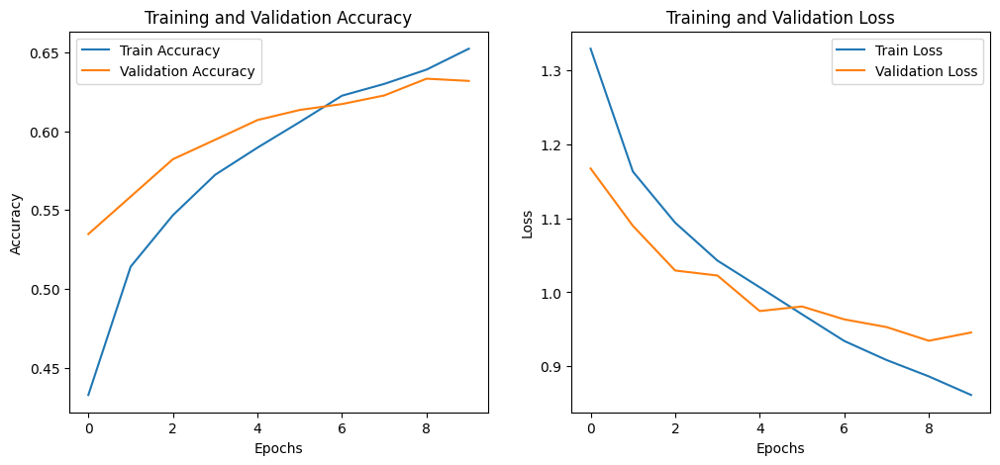

0.5804754167795181

In [ ]:
train_model(4, train_generator, val_generator)

**SPLITS_5**

In [ ]:
file_train_5 = os.path.join(base_folder, f'MotocycleDataset-Splits-5-Train.csv')
file_val_5 = os.path.join(base_folder, f'MotocycleDataset-Splits-5-Test.csv')

name_colums = ['ImageFullPath', 'CategoryID']
df_train_5 = pd.read_csv(file_train_5, names = name_colums)
df_val_5 = pd.read_csv(file_val_5, names = name_colums)

In [ ]:
# Kiểm tra và loại bỏ các hình ảnh không hợp lệ từ DataFrame
df_train_5 = filter_valid_images(df_train_5, base_folder, 'ImageFullPath', image_size, preprocess_input)
df_val_5 = filter_valid_images(df_val_5, base_folder, 'ImageFullPath', image_size, preprocess_input)

In [ ]:
df_train_5['CategoryID'] = df_train_5['CategoryID'].astype(str)  # Chuyển int sang string
df_val_5['CategoryID'] = df_val_5['CategoryID'].astype(str)  # Chuyển int sang string

print(df_train_5.shape)
print(df_val_5.shape)

(25588, 2)
(6395, 2)


In [ ]:
train_generator, val_generator = generator(df_train_5, df_val_5, base_folder, image_size)

Found 25588 validated image filenames belonging to 5 classes.
Found 6395 validated image filenames belonging to 5 classes.


Epoch 1/10
800/800 [==============================] - 1480s 2s/step - loss: 1.3247 - accuracy: 0.4311 - val_loss: 1.1894 - val_accuracy: 0.5171
Epoch 2/10
800/800 [==============================] - 1426s 2s/step - loss: 1.1638 - accuracy: 0.5157 - val_loss: 1.0849 - val_accuracy: 0.5678
Epoch 3/10
800/800 [==============================] - 1344s 2s/step - loss: 1.0882 - accuracy: 0.5574 - val_loss: 1.0473 - val_accuracy: 0.5731
Epoch 4/10
800/800 [==============================] - 1351s 2s/step - loss: 1.0308 - accuracy: 0.5798 - val_loss: 1.0107 - val_accuracy: 0.6052
Epoch 5/10
800/800 [==============================] - 1280s 2s/step - loss: 0.9970 - accuracy: 0.5977 - val_loss: 0.9806 - val_accuracy: 0.6120
Epoch 6/10
800/800 [==============================] - 1275s 2s/step - loss: 0.9576 - accuracy: 0.6117 - val_loss: 0.9671 - val_accuracy: 0.6186
Epoch 7/10
800/800 [==============================] - 1274s 2s/step - loss: 0.9184 - accuracy: 0.6286 - val_loss: 0.9331 - val_accuracy:

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


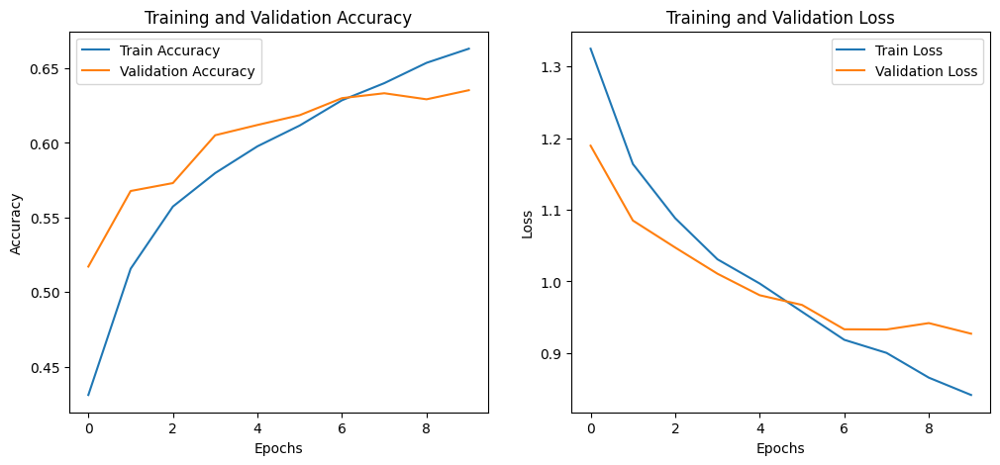

0.5878888607025147

In [ ]:
train_model(5, train_generator, val_generator)

# ĐÁNH GIÁ MODEL

1. Yêu cầu chung: Đánh giá model thông qua các độ đo như độ chính xác (accuracy) và confusion matrix

2. Yêu cầu cụ thể:
  - Input:
      - Tập tin chứa ground-truth (đáp án). Tức là với mỗi ảnh, CategoryID đã biết lúc annotate ở bước chuẩn bị dữ liệu.
      - Tập tin chứa kết quả prediction từ model (kết quả của bước huấn luyện - Training)
  - Output:
      - Confusion matrix A. Xem hướng dẫn: https://www.v7labs.com/blog/confusion-matrix-guide. Aij là số ảnh của CategoryID=i - được dự đoán là CategoryID=j. Aii là số mẫu được dự đoán đúng của CategoryID=i.
      - Accuracy = số lượng ảnh dự đoán đúng chia tổng số ảnh được dự đoán

3. Test thử
  - Lấy ra tập tin Test của Split1: MotocycleDataset-Splits-1-Test.csv. Đây là tập tin chứa ground-truth
  - Từ tập tin này, tạo ra tập tin  MotocycleDataset-Splits-1-Test-Pred.csv đóng vai trò như tập tin chứa kết quả prediction từ model. Chúng ta chưa có model để test, do đó, hãy tạo ngẫu nhiên các kết quả prediction (=CategoryID) để gán cho mỗi ảnh trong tập MotocycleDataset-Splits-1-Test.csv

4. Test thiệt
  - Nếu có file model thì apply model để cho ra kết quả prediction

5. Submission

  - Ghi kết quả ra tập tin theo chế độ Append: https://drive.google.com/file/d/1qjGycdcIqsoag_yaVqY8UAUNmpFUkVFe/view?usp=sharing
  - Quy ước:
    - Date: ví dụ 2024-06-11 10:32:19 (dùng hàm formatted_date = now.strftime("%Y-%m-%d %H:%M:%S"))
    - GroupID: các MSSV của thành viên trong nhóm cách nhau bằng dấu gạch ngang -, ví dụ 21522446-21522243
    - SplitID: giá trị từ 1 đến 5
    - Accuracy: giá trị theo quy ước dấu . phân cách phần thập phân, ví dụ 90.2345 - lấy đến 4 số thập phân
    - Desc: mô tả phương pháp, ví dụ Random. Mỗi nhóm có thể có rất nhiều trials, do đó cần phải mô tả tóm tắt về các trial để còn nhận diện
  


In [ ]:
from datetime import datetime
import pytz
import csv, os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, accuracy_score
from keras.models import load_model

base_path = '/content/drive/MyDrive'
base_folder = '/content/drive/MyDrive/Public'

In [ ]:
# Hàm để tải và tiền xử lý ảnh
def load_and_preprocess_image(img_path, target_size=(224, 224)):
    img = image.load_img(img_path, target_size=target_size)
    img_data = image.img_to_array(img)
    img_data = np.expand_dims(img_data, axis=0)
    img_data = preprocess_input(img_data)
    return img_data

**Model_1**

In [ ]:
model_path = os.path.join(base_path, 'model1.h5')
model = load_model(model_path)

file_test = os.path.join(base_folder, 'MotocycleDataset-Splits-1-Test.csv')
file_test_pred = os.path.join(base_path, 'MotocycleDataset-Splits-1-Test-Pred.csv')

name_colums = ['ImageFullPath', 'CategoryID']
df_test = pd.read_csv(file_test, names = name_colums)

In [ ]:
predictions = []

# Dự đoán cho từng ảnh trong file CSV
for index, row in df_test.iterrows():
    img_path = os.path.join(base_folder, row['ImageFullPath'])
    if os.path.exists(img_path):
      try:
        img_data = load_and_preprocess_image(img_path)
        pred = model.predict(img_data)
        pred_class = np.argmax(pred, axis=1)[0]
        predictions.append(pred_class)
      except Exception as e:
        predictions.append(4)
    else:
        predictions.append(4)  # Nếu ảnh không tồn tại

# Thêm kết quả dự đoán vào DataFrame
df_test['PredictedCategoryID'] = predictions

# Lưu kết quả dự đoán vào file CSV mới
df_test.to_csv(file_test_pred, index=False)

1/1 [==============================] - 0s 76ms/step


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
1/1 [==============================] - 0s 55ms/step


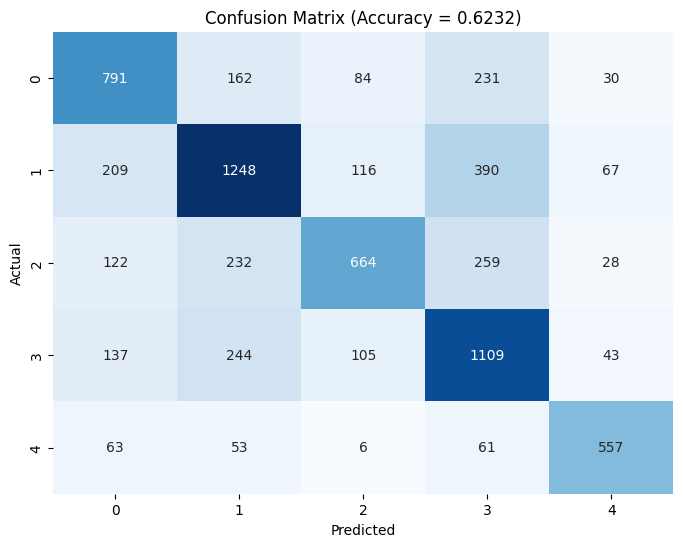

In [ ]:
# Giả sử y_test và y_pred là các mảng đã được tính toán trước đó
y_test = np.array(df_test['CategoryID'])
y_pred = np.array(df_test['PredictedCategoryID'])

# Tính toán confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Tính accuracy
accuracy = accuracy_score(y_test, y_pred)

# Vẽ confusion matrix bằng seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title(f'Confusion Matrix (Accuracy = {accuracy:.4f})')
plt.show()


**Model_2**

In [ ]:
model_path = os.path.join(base_path, 'model2.h5')
model = load_model(model_path)

file_test = os.path.join(base_folder, 'MotocycleDataset-Splits-1-Test.csv')
file_test_pred = os.path.join(base_path, 'MotocycleDataset-Splits-2-Test-Pred.csv')

name_colums = ['ImageFullPath', 'CategoryID']
df_test = pd.read_csv(file_test, names = name_colums)

In [ ]:
predictions = []

# Dự đoán cho từng ảnh trong file CSV
for index, row in df_test.iterrows():
    img_path = os.path.join(base_folder, row['ImageFullPath'])
    if os.path.exists(img_path):
      try:
        img_data = load_and_preprocess_image(img_path)
        pred = model.predict(img_data)
        pred_class = np.argmax(pred, axis=1)[0]
        predictions.append(pred_class)
      except Exception as e:
        predictions.append(4)
    else:
        predictions.append(4)  # Nếu ảnh không tồn tại

# Thêm kết quả dự đoán vào DataFrame
df_test['PredictedCategoryID'] = predictions

# Lưu kết quả dự đoán vào file CSV mới
df_test.to_csv(file_test_pred, index=False)

1/1 [==============================] - 0s 52ms/step


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
1/1 [==============================] - 0s 61ms/step


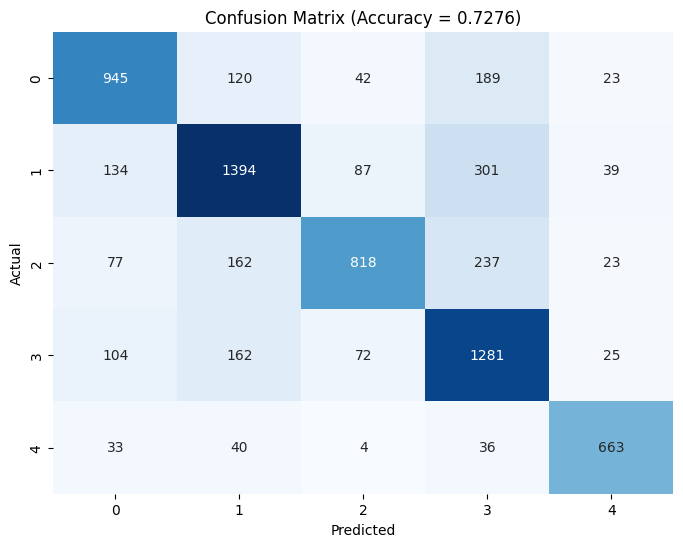

In [ ]:
# Giả sử y_test và y_pred là các mảng đã được tính toán trước đó
y_test = np.array(df_test['CategoryID'])
y_pred = np.array(df_test['PredictedCategoryID'])

# Tính toán confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Tính accuracy
accuracy = accuracy_score(y_test, y_pred)

# Vẽ confusion matrix bằng seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title(f'Confusion Matrix (Accuracy = {accuracy:.4f})')
plt.show()

**Model_3**

In [ ]:
model_path = os.path.join(base_path, 'model3.h5')
model = load_model(model_path)

file_test = os.path.join(base_folder, 'MotocycleDataset-Splits-1-Test.csv')
file_test_pred = os.path.join(base_path, 'MotocycleDataset-Splits-3-Test-Pred.csv')

name_colums = ['ImageFullPath', 'CategoryID']
df_test = pd.read_csv(file_test, names = name_colums)

In [ ]:
predictions = []

# Dự đoán cho từng ảnh trong file CSV
for index, row in df_test.iterrows():
    img_path = os.path.join(base_folder, row['ImageFullPath'])
    if os.path.exists(img_path):
      try:
        img_data = load_and_preprocess_image(img_path)
        pred = model.predict(img_data)
        pred_class = np.argmax(pred, axis=1)[0]
        predictions.append(pred_class)
      except Exception as e:
        predictions.append(4)
    else:
        predictions.append(4)  # Nếu ảnh không tồn tại

# Thêm kết quả dự đoán vào DataFrame
df_test['PredictedCategoryID'] = predictions

# Lưu kết quả dự đoán vào file CSV mới
df_test.to_csv(file_test_pred, index=False)

1/1 [==============================] - 0s 50ms/step


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
1/1 [==============================] - 0s 51ms/step


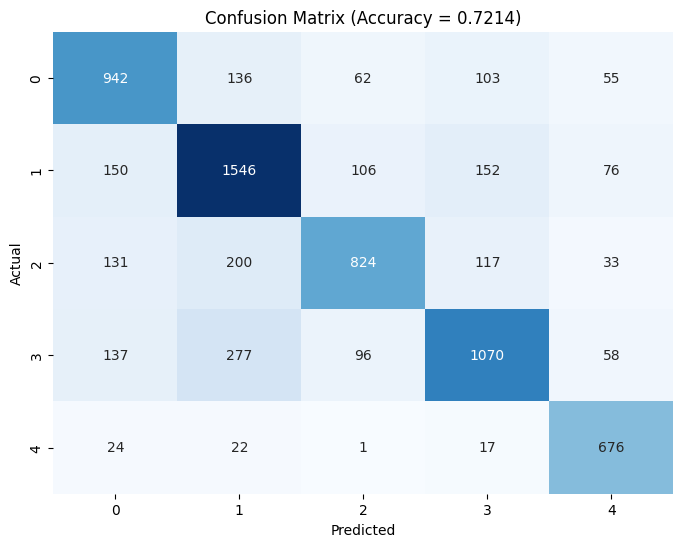

In [ ]:
# Giả sử y_test và y_pred là các mảng đã được tính toán trước đó
y_test = np.array(df_test['CategoryID'])
y_pred = np.array(df_test['PredictedCategoryID'])

# Tính toán confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Tính accuracy
accuracy = accuracy_score(y_test, y_pred)

# Vẽ confusion matrix bằng seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title(f'Confusion Matrix (Accuracy = {accuracy:.4f})')
plt.show()

**Model_4**

In [ ]:
model_path = os.path.join(base_path, 'model4.h5')
model = load_model(model_path)

file_test = os.path.join(base_folder, 'MotocycleDataset-Splits-1-Test.csv')
file_test_pred = os.path.join(base_path, 'MotocycleDataset-Splits-4-Test-Pred.csv')

name_colums = ['ImageFullPath', 'CategoryID']
df_test = pd.read_csv(file_test, names = name_colums)

In [ ]:
predictions = []

# Dự đoán cho từng ảnh trong file CSV
for index, row in df_test.iterrows():
    img_path = os.path.join(base_folder, row['ImageFullPath'])
    if os.path.exists(img_path):
      try:
        img_data = load_and_preprocess_image(img_path)
        pred = model.predict(img_data)
        pred_class = np.argmax(pred, axis=1)[0]
        predictions.append(pred_class)
      except Exception as e:
        predictions.append(4)
    else:
        predictions.append(4)  # Nếu ảnh không tồn tại

# Thêm kết quả dự đoán vào DataFrame
df_test['PredictedCategoryID'] = predictions

# Lưu kết quả dự đoán vào file CSV mới
df_test.to_csv(file_test_pred, index=False)

1/1 [==============================] - 0s 51ms/step


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
1/1 [==============================] - 0s 60ms/step


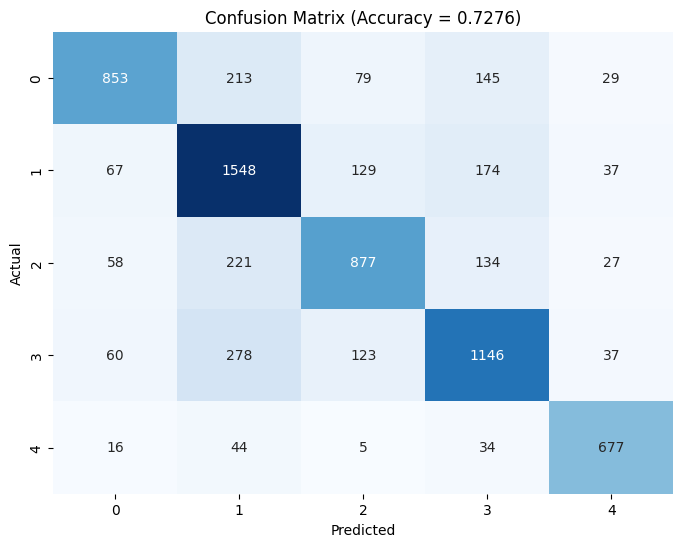

In [ ]:
# Giả sử y_test và y_pred là các mảng đã được tính toán trước đó
y_test = np.array(df_test['CategoryID'])
y_pred = np.array(df_test['PredictedCategoryID'])

# Tính toán confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Tính accuracy
accuracy = accuracy_score(y_test, y_pred)

# Vẽ confusion matrix bằng seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title(f'Confusion Matrix (Accuracy = {accuracy:.4f})')
plt.show()

**Model_5**

In [ ]:
model_path = os.path.join(base_path, 'model5.h5')
model = load_model(model_path)

file_test = os.path.join(base_folder, 'MotocycleDataset-Splits-1-Test.csv')
file_test_pred = os.path.join(base_path, 'MotocycleDataset-Splits-2-Test-Pred.csv')

name_colums = ['ImageFullPath', 'CategoryID']
df_test = pd.read_csv(file_test, names = name_colums)

In [ ]:
predictions = []

# Dự đoán cho từng ảnh trong file CSV
for index, row in df_test.iterrows():
    img_path = os.path.join(base_folder, row['ImageFullPath'])
    if os.path.exists(img_path):
      try:
        img_data = load_and_preprocess_image(img_path)
        pred = model.predict(img_data)
        pred_class = np.argmax(pred, axis=1)[0]
        predictions.append(pred_class)
      except Exception as e:
        predictions.append(4)
    else:
        predictions.append(4)  # Nếu ảnh không tồn tại

# Thêm kết quả dự đoán vào DataFrame
df_test['PredictedCategoryID'] = predictions

# Lưu kết quả dự đoán vào file CSV mới
df_test.to_csv(file_test_pred, index=False)

1/1 [==============================] - 0s 50ms/step


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
1/1 [==============================] - 0s 47ms/step


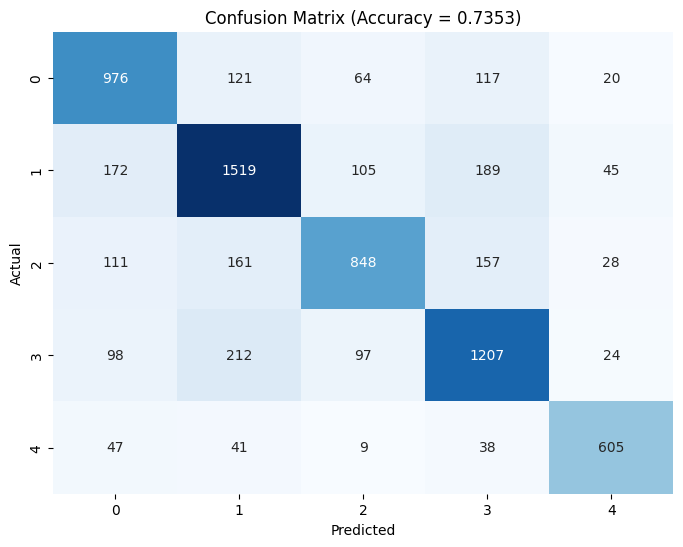

In [ ]:
# Giả sử y_test và y_pred là các mảng đã được tính toán trước đó
y_test = np.array(df_test['CategoryID'])
y_pred = np.array(df_test['PredictedCategoryID'])

# Tính toán confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Tính accuracy
accuracy = accuracy_score(y_test, y_pred)

# Vẽ confusion matrix bằng seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title(f'Confusion Matrix (Accuracy = {accuracy:.4f})')
plt.show()

**Submission**

In [ ]:
# Lấy thời gian hiện tại theo múi giờ cụ thể
timezone = pytz.timezone('Asia/Ho_Chi_Minh')  # Thay đổi thành múi giờ của bạn nếu cần
now = datetime.now(timezone)

# Định dạng thời gian hiện tại theo định dạng mong muốn
formatted_date = now.strftime("%Y-%m-%d %H:%M:%S")

#data = [formatted_date, '22521184 - 22521031 - 22520197 - 22520658', '1', '0.6232', 'MobileNetV2 + Adam']
#data1 = [formatted_date, '22521184 - 22521031 - 22520197 - 22520658', '2', '0.7276', 'MobileNetV2 + Adam']
#data2 = [formatted_date, '22521184 - 22521031 - 22520197 - 22520658', '3', '0.7214', 'MobileNetV2 + Adam']
#data3 = [formatted_date, '22521184 - 22521031 - 22520197 - 22520658', '4', '0.7276', 'MobileNetV2 + Adam']
data4 = [formatted_date, '22521184 - 22521031 - 22520197 - 22520658', '5', '0.7353', 'MobileNetV2 + Adam']

base_folder = '/content/drive/MyDrive/Public'
file_path = os.path.join(base_folder, 'CS114.O21-O21.KHCL.ScoreBoard.csv')

with open(file_path, 'a', newline='') as file:
  write = csv.writer(file)
  write.writerow(data4)